In [1]:
import os
import math
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

In [2]:
def mask_convex_hull(mask):
    # Find object with the maximum convex hull and draw it on the image
    
    contours, hierarchy = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    contours = sorted(contours, key=lambda contour: cv2.contourArea(contour), reverse=True)
    
    contour_label = np.zeros_like(mask)
    
    cv2.drawContours(contour_label, contours, 0, 255, 1)
    
    return contour_label

def find_hesse_intersection(line_1, line_2):
    # xcos(t1) + ysin(t1) = r1
    # xcos(t2) + ysin(t2) = r2
    
    # or
    
    # [ cos(t1) sin(t1) ] [x] = [r1]
    # [ cos(t2) sin(t2) ] [y] = [r2]
    
    A = np.array([
        [np.cos(line_1[1]), np.sin(line_1[1])],
        [np.cos(line_2[1]), np.sin(line_2[1])]
    ])
        
    b = np.matrix([[line_1[0], line_2[0]]]).T
    
    res = np.linalg.solve(A, b)
    
    x = res[0, 0]
    y = res[1, 0]
    
    return x, y

def find_quadrilateral_points(label, intersection_tolerance=0.01):
    convex_hull = mask_convex_hull(label)
    
    lines = cv2.HoughLines(convex_hull, rho=1, theta=np.pi/720, threshold=10)
    
    # Find four of the most rated lines that are sufficiently 
    # distinct
    
    current_lines = []
    
    for rho, theta in lines.squeeze():        
        invalidate = False
        for existing_rho, existing_theta in current_lines:
            # Pass on lines that are similar to already discovered
            if abs(rho-existing_rho) < 10 and abs(theta-existing_theta) < np.pi/40:
                invalidate = True
                break
            # Also check for similarity in the "discontinuity" of the transform
            if abs(abs(rho)-abs(existing_rho)) < 10 and np.pi*0.98 < abs(abs(theta)-abs(existing_theta)) < np.pi*1.02:
                invalidate = True
                break
        if not invalidate:
            current_lines.append((rho, theta))
            
        if len(current_lines) == 4:
            break
            
    points = []
    
    abs_tol = intersection_tolerance*label.shape[0]+intersection_tolerance*label.shape[1]

            
    for l1_idx, l1 in enumerate(current_lines):
        for l2 in current_lines[l1_idx+1:]:
            try:
                i_x, i_y = find_hesse_intersection(l1, l2)
            except:
                continue
            
            if i_x < label.shape[1]+abs_tol and i_x >= -abs_tol and i_y < label.shape[0]+abs_tol and i_y >= -abs_tol:
                points.append({'x': i_x, 'y': i_y})
    return points
        
def correct_perspective(image, mask):
    quad_points = find_quadrilateral_points(label)

    
    def center_angle(point, ref_y, ref_x):
        px = point['x']-ref_x
        py = point['y']-ref_y
        return np.arctan2(py, px)

    
    center_x = sum(point['x'] for point in quad_points)/4
    center_y = sum(point['y'] for point in quad_points)/4
    
    
    target_points = [
        {'x': image.shape[1], 'y': 0},
        {'x': 0, 'y': 0},
        {'x': 0, 'y': image.shape[0]},
        {'x': image.shape[1], 'y': image.shape[0]},
    ]  
    
    target_points = sorted(target_points, key=lambda point: center_angle(point, center_y, center_x))
    quad_points = sorted(quad_points, key=lambda point: center_angle(point, center_y, center_x))
    
    target_mat = np.matrix([[p['x'], p['y']] for p in target_points], np.float32)
    dst_mat = np.matrix([[p['x'], p['y']] for p in quad_points], np.float32)
    
    tr = cv2.getPerspectiveTransform(
        src = target_mat,
        dst = dst_mat
    )
    
    inv_tr = np.linalg.inv(tr)
    
    return inv_tr, cv2.warpPerspective(image, inv_tr, (image.shape[1], image.shape[0]))

In [3]:
sample_images = ['1.png', '2.png', '3.png', '4.png']
sample_labels = ['1.label.png', '2.label.png', '3.label.png', '4.label.png']

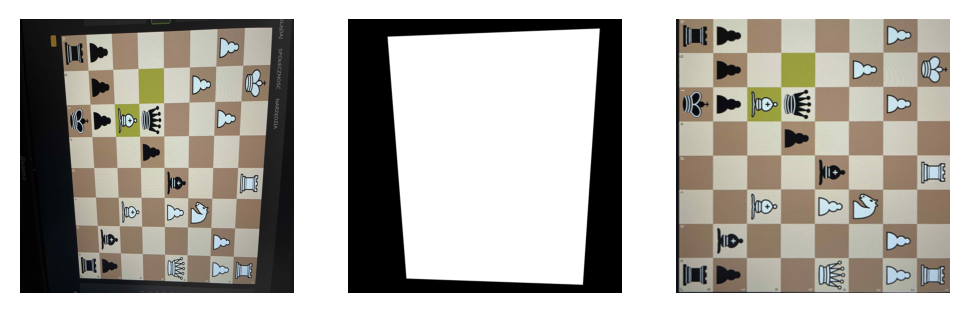

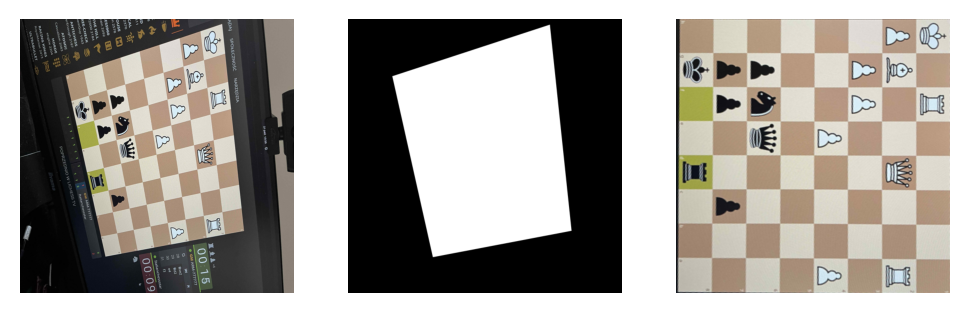

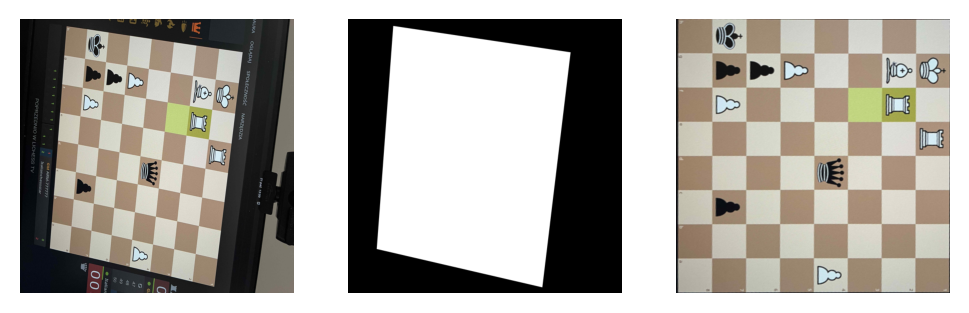

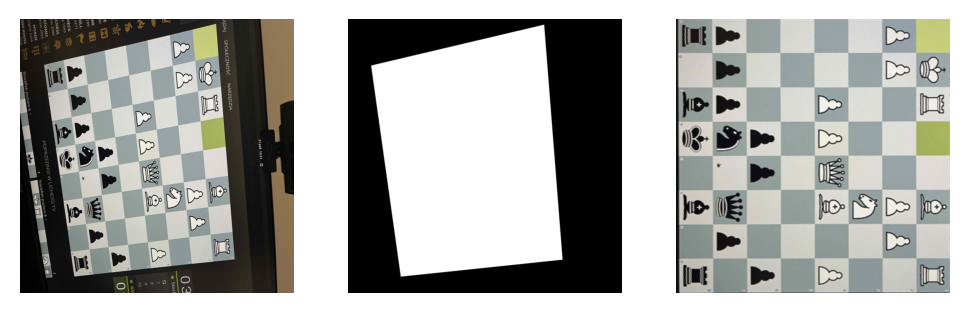

In [4]:
for im, lab in zip(sample_images, sample_labels):
    sample_im = os.path.join("..", "segmentation_data", im)
    sample_lab = os.path.join("..", "segmentation_data", lab)
    image, label = np.array(Image.open(sample_im).resize((512, 512))), np.array(Image.open(sample_lab).resize((512, 512)))
    transform, after_correction = correct_perspective(image, label)
    plt.subplot(1, 3, 1)
    plt.axis("off")
    plt.imshow(image)
    plt.subplot(1, 3, 2)
    plt.axis("off")
    plt.imshow(label, plt.cm.gray)
    plt.subplot(1, 3, 3)
    plt.axis("off")
    plt.imshow(after_correction)
    plt.gcf().set_dpi(200)
    plt.show()

## Current pipeline with trained model

In [5]:
import tensorflow.keras as keras

2022-11-09 15:12:04.265796: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-11-09 15:12:04.463611: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2022-11-09 15:12:05.006933: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /home/karol/.local/lib/python3.10/site-packages/cv2/../../lib64:/usr/local/cuda-11.8/lib64:
2022-11-09 15:12:05.007011: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic libra

In [6]:
segmentation_model = keras.models.load_model('../models/finetuned_model.h5')

2022-11-09 15:12:06.165969: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-09 15:12:06.193798: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-09 15:12:06.194052: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-09 15:12:06.194873: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

2022-11-09 15:12:12.739699: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8600
2022-11-09 15:12:13.520449: I tensorflow/stream_executor/cuda/cuda_blas.cc:1614] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


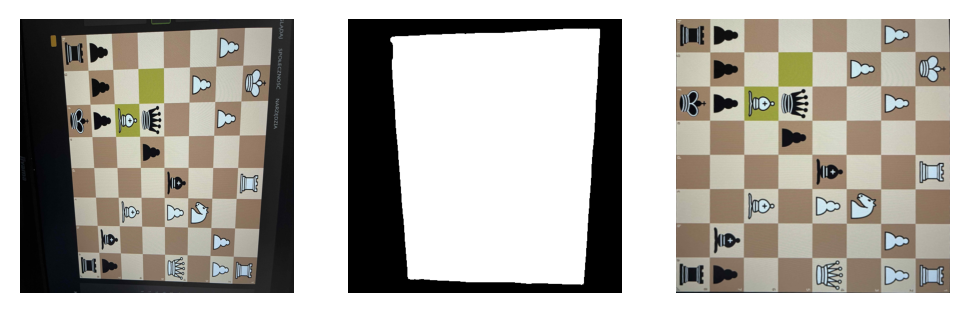

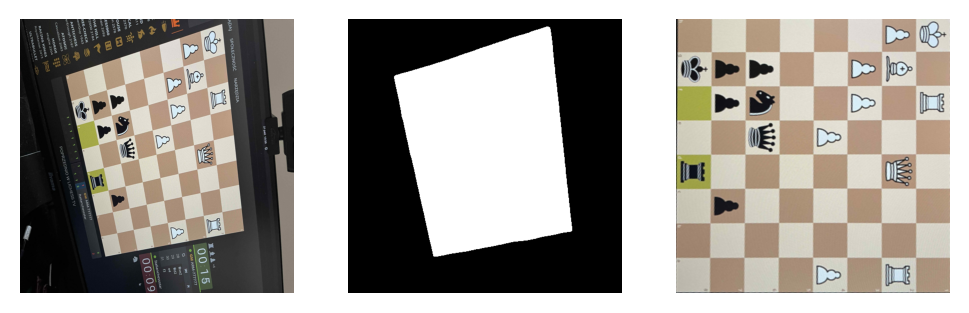

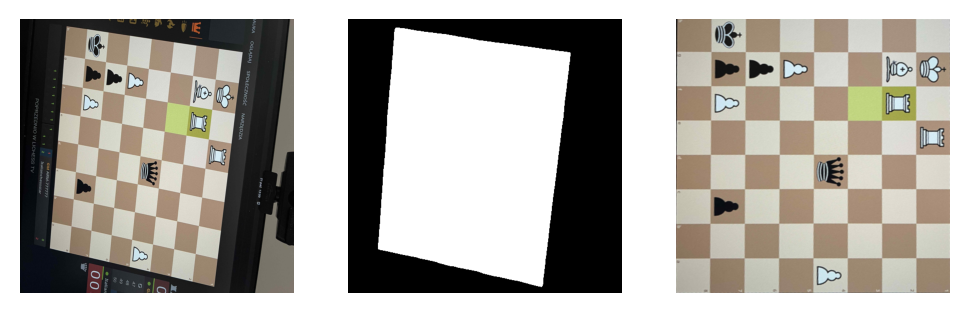

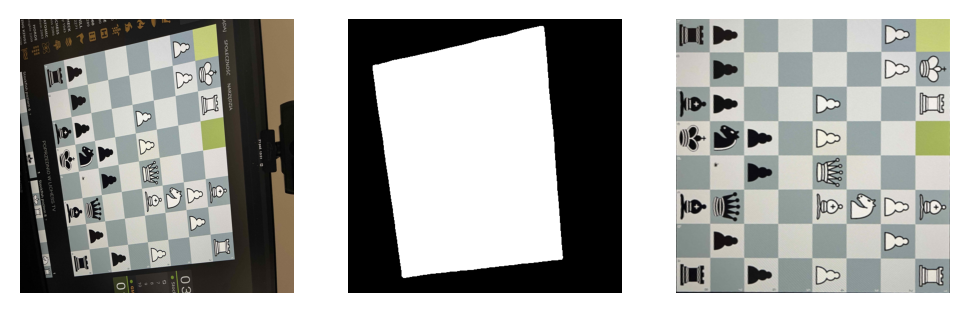

In [7]:
for im, lab in zip(sample_images, sample_labels):
    sample_im = os.path.join("..", "segmentation_data", im)
    image = np.array(Image.open(sample_im).resize((512, 512)))
    image = image.astype(np.float32)/255
    
    label = segmentation_model(np.expand_dims(image, axis=0))
    label = np.array(np.squeeze(label))
    label[label > 0.5] = 255
    label[label <= 0.5] = 0
    label = label.astype(np.uint8)
    points, after_correction = correct_perspective(image, label)
    plt.subplot(1, 3, 1)
    plt.axis("off")
    plt.imshow(image)
    plt.subplot(1, 3, 2)
    plt.axis("off")
    plt.imshow(label, plt.cm.gray)
    plt.subplot(1, 3, 3)
    plt.axis("off")
    plt.imshow(after_correction)
    plt.gcf().set_dpi(200)
    plt.show()

### Slice images into classification samples

Load rotation metadata and keypoint labels

In [8]:
import pandas as pd
import json
rotation = np.array(pd.read_csv(os.path.join("..", "source_diagrams", "rotation_data.csv"), header=None))
with open(os.path.join("..", 'out.json'), 'r') as lf:
    keypoint_dict = json.load(lf)

rotations = {}

for fname, rotation in rotation:
    name, _ = os.path.splitext(fname)
    rotations[name] = rotation

In [9]:
data_dir = os.path.join("..", "segmentation_data")

sources, images, labels, keypoints, rotation = [], [], [], [], []

for file in os.listdir(data_dir):
    name, ext = os.path.splitext(file)
    
    if name.endswith('.label'):
        continue
    
    
    image = Image.open(os.path.join(data_dir, file)).resize((512, 512))

    label_path = name + ".label.png"
    
    label = Image.open(os.path.join(data_dir, label_path)).resize((512, 512))
    
    keypoint_name = name + '.jpg'
    
    if rotations[name] == "right":
        image = image.rotate(90)
        label = label.rotate(90)
    elif rotations[name] == "left":
        image = image.rotate(-90)
        label = label.rotate(-90)
    elif rotations[name] == "upside":
        image = image.rotate(180)
        label = label.rotate(180)
    
    image = np.array(image).astype(np.float32)/255
    label = np.array(label).astype(np.uint8)
    
    sources.append(file)
    images.append(image)
    labels.append(label)
    keypoints.append(keypoint_dict[keypoint_name]['figures'])
    rotation.append(rotations[name])

In [10]:
def rotate_point(px, py, origin_x, origin_y, angle):
    
    point_cpx =  (px+py*1j - origin_x-origin_y*1j) * np.exp(complex(0, angle)) + origin_x + origin_y*1j
    return point_cpx.real, point_cpx.imag


33.png


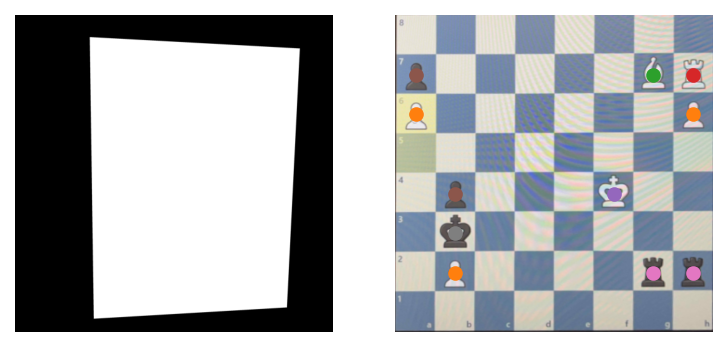

[[0 0 0 0 0 0 0 0]
 [5 0 0 0 0 0 2 3]
 [1 0 0 0 0 0 0 1]
 [0 0 0 0 0 0 0 0]
 [0 5 0 0 0 4 0 0]
 [0 7 0 0 0 0 0 0]
 [0 1 0 0 0 0 6 6]
 [0 0 0 0 0 0 0 0]]
7.png


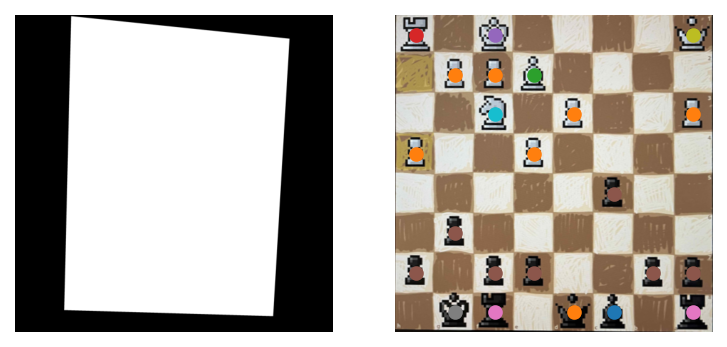

[[ 3  0  4  0  0  0  0  8]
 [ 0  1  1  2  0  0  0  0]
 [ 0  0  9  0  1  0  0  1]
 [ 1  0  0  1  0  0  0  0]
 [ 0  0  0  0  0  5  0  0]
 [ 0  5  0  0  0  0  0  0]
 [ 5  0  5  5  0  0  5  5]
 [ 0  7  6  0 11 10  0  6]]
56.png


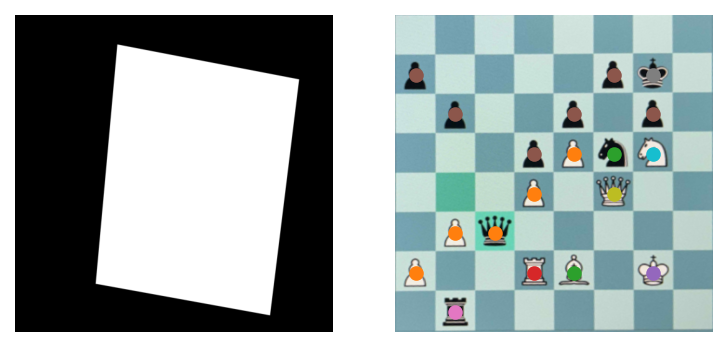

[[ 0  0  0  0  0  0  0  0]
 [ 5  0  0  0  0  5  7  0]
 [ 0  5  0  0  5  0  5  0]
 [ 0  0  0  5  1 12  9  0]
 [ 0  0  0  1  0  8  0  0]
 [ 0  1 11  0  0  0  0  0]
 [ 1  0  0  3  2  0  4  0]
 [ 0  6  0  0  0  0  0  0]]
75.png


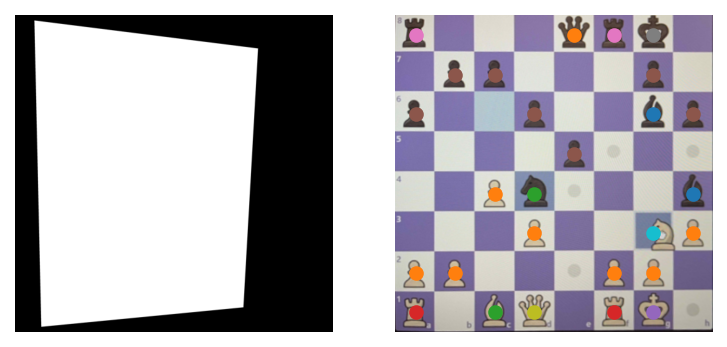

[[ 6  0  0  0 11  6  7  0]
 [ 0  5  5  0  0  0  5  0]
 [ 5  0  0  5  0  0 10  5]
 [ 0  0  0  0  5  0  0  0]
 [ 0  0  1 12  0  0  0 10]
 [ 0  0  0  1  0  0  9  1]
 [ 1  1  0  0  0  1  1  0]
 [ 3  0  2  8  0  3  4  0]]
11.png


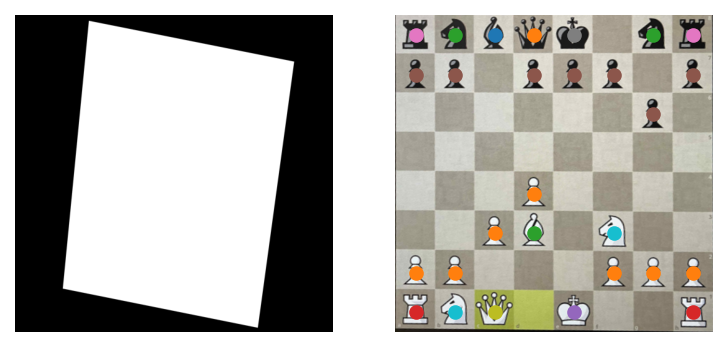

[[ 6 12 10 11  7  0 12  6]
 [ 5  5  0  5  5  5  0  5]
 [ 0  0  0  0  0  0  5  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  1  0  0  0  0]
 [ 0  0  1  2  0  9  0  0]
 [ 1  1  0  0  0  1  1  1]
 [ 3  9  8  0  4  0  0  3]]
63.png


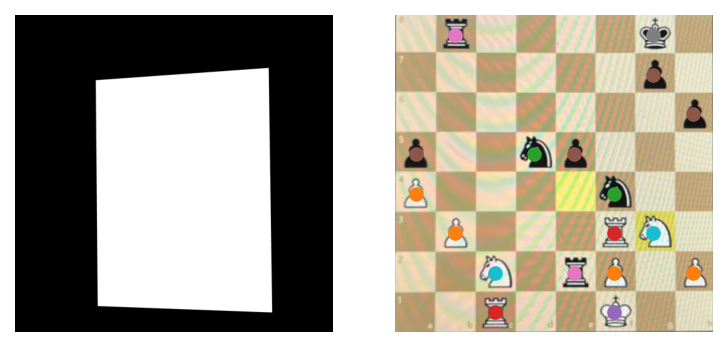

[[ 0  6  0  0  0  0  7  0]
 [ 0  0  0  0  0  0  5  0]
 [ 0  0  0  0  0  0  0  5]
 [ 5  0  0 12  5  0  0  0]
 [ 1  0  0  0  0 12  0  0]
 [ 0  1  0  0  0  3  9  0]
 [ 0  0  9  0  6  1  0  1]
 [ 0  0  3  0  0  4  0  0]]
73.png


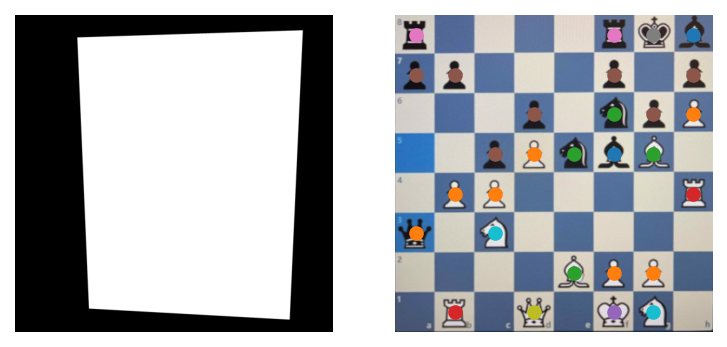

[[ 6  0  0  0  0  6  7 10]
 [ 5  5  0  0  0  5  0  5]
 [ 0  0  0  5  0 12  5  1]
 [ 0  0  5  1 12 10  2  0]
 [ 0  1  1  0  0  0  0  3]
 [11  0  9  0  0  0  0  0]
 [ 0  0  0  0  2  1  1  0]
 [ 0  3  0  8  0  4  9  0]]
38.png


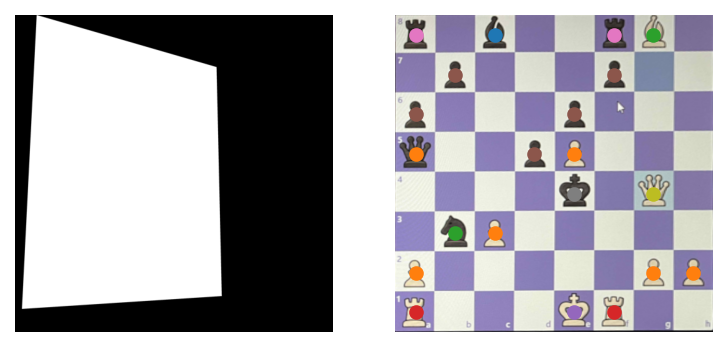

[[ 6  0 10  0  0  6  2  0]
 [ 0  5  0  0  0  5  0  0]
 [ 5  0  0  0  5  0  0  0]
 [11  0  0  5  1  0  0  0]
 [ 0  0  0  0  7  0  8  0]
 [ 0 12  1  0  0  0  0  0]
 [ 1  0  0  0  0  0  1  1]
 [ 3  0  0  0  4  3  0  0]]
50.png


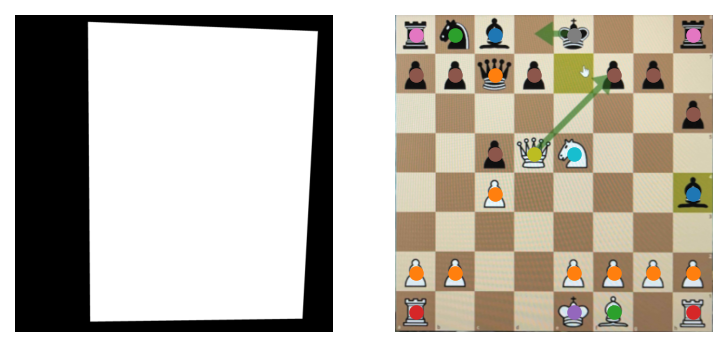

[[ 6 12 10  0  7  0  0  6]
 [ 5  5 11  5  0  5  5  0]
 [ 0  0  0  0  0  0  0  5]
 [ 0  0  5  8  9  0  0  0]
 [ 0  0  1  0  0  0  0 10]
 [ 0  0  0  0  0  0  0  0]
 [ 1  1  0  0  1  1  1  1]
 [ 3  0  0  0  4  2  0  3]]
39.png


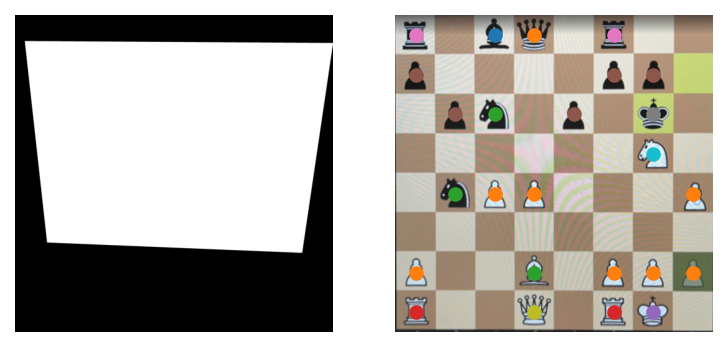

[[ 6  0 10 11  0  6  0  0]
 [ 5  0  0  0  0  5  5  0]
 [ 0  5 12  0  5  0  7  0]
 [ 0  0  0  0  0  0  9  0]
 [ 0 12  1  1  0  0  0  1]
 [ 0  0  0  0  0  0  0  0]
 [ 1  0  0  2  0  1  1  1]
 [ 3  0  0  8  0  3  4  0]]
84.png


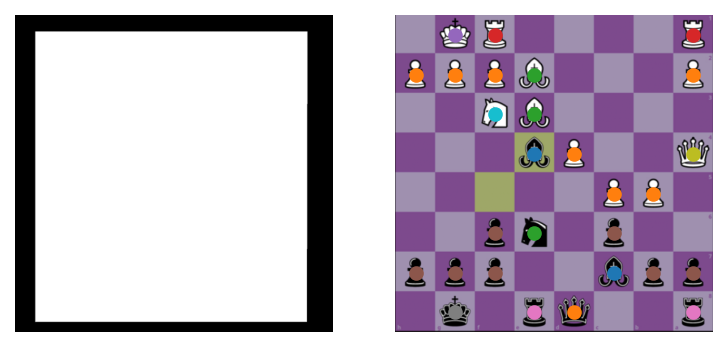

[[ 0  4  3  0  0  0  0  3]
 [ 1  1  1  2  0  0  0  1]
 [ 0  0  9  2  0  0  0  0]
 [ 0  0  0 10  1  0  0  8]
 [ 0  0  0  0  0  1  1  0]
 [ 0  0  5 12  0  5  0  0]
 [ 5  5  5  0  0 10  5  5]
 [ 0  7  0  6 11  0  0  6]]
71.png


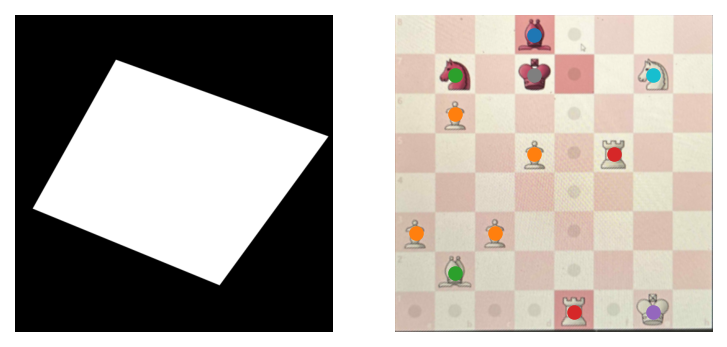

[[ 0  0  0 10  0  0  0  0]
 [ 0 12  0  7  0  0  9  0]
 [ 0  1  0  0  0  0  0  0]
 [ 0  0  0  1  0  3  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 1  0  1  0  0  0  0  0]
 [ 0  2  0  0  0  0  0  0]
 [ 0  0  0  0  3  0  4  0]]
70.png


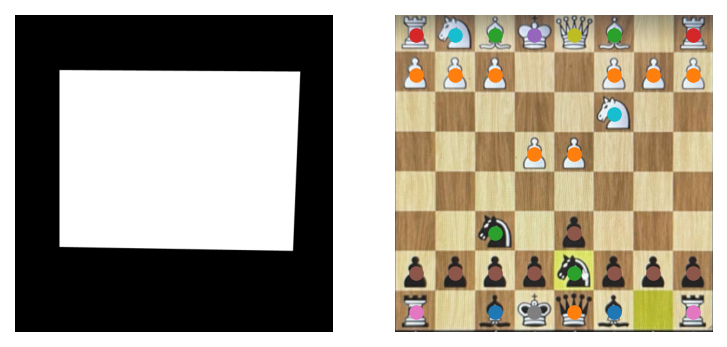

[[ 3  9  2  4  8  2  0  3]
 [ 1  1  1  0  0  1  1  1]
 [ 0  0  0  0  0  9  0  0]
 [ 0  0  0  1  1  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0 12  0  5  0  0  0]
 [ 5  5  5  5 12  5  5  5]
 [ 6  0 10  7 11 10  0  6]]
16.png


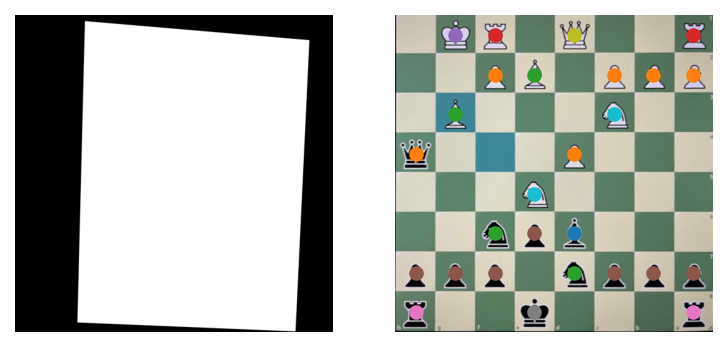

[[ 0  4  3  0  8  0  0  3]
 [ 0  0  1  2  0  1  1  1]
 [ 0  2  0  0  0  9  0  0]
 [11  0  0  0  1  0  0  0]
 [ 0  0  0  9  0  0  0  0]
 [ 0  0 12  5 10  0  0  0]
 [ 5  5  5  0 12  5  5  5]
 [ 6  0  0  7  0  0  0  6]]
10.png


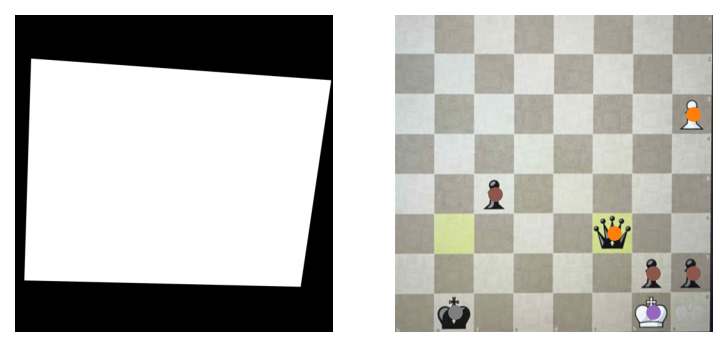

[[ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  1]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  5  0  0  0  0  0]
 [ 0  0  0  0  0 11  0  0]
 [ 0  0  0  0  0  0  5  5]
 [ 0  7  0  0  0  0  4  0]]
42.png


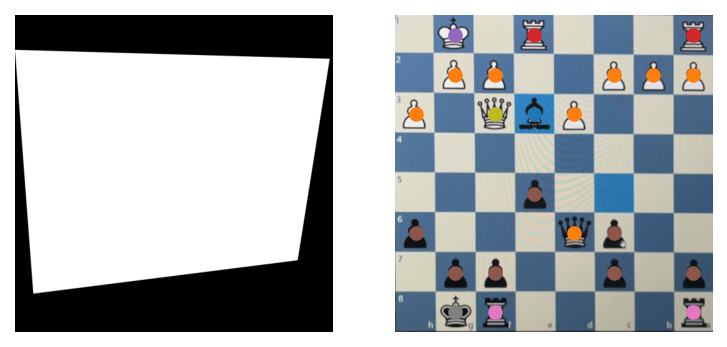

[[ 0  4  0  3  0  0  0  3]
 [ 0  1  1  0  0  1  1  1]
 [ 1  0  8 10  1  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  5  0  0  0  0]
 [ 5  0  0  0 11  5  0  0]
 [ 0  5  5  0  0  5  0  5]
 [ 0  7  6  0  0  0  0  6]]
58.png


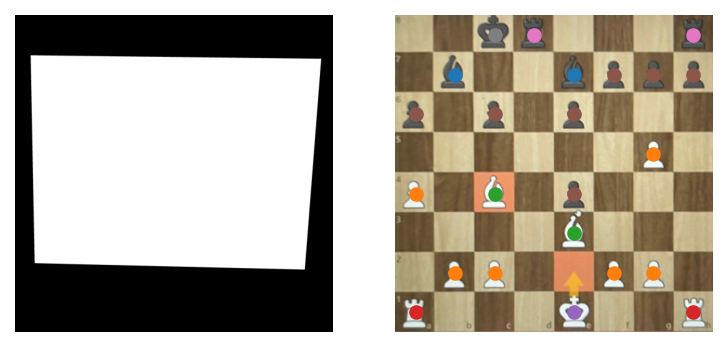

[[ 0  0  7  6  0  0  0  6]
 [ 0 10  0  0 10  5  5  5]
 [ 5  0  5  0  5  0  0  0]
 [ 0  0  0  0  0  0  1  0]
 [ 1  0  2  0  5  0  0  0]
 [ 0  0  0  0  2  0  0  0]
 [ 0  1  1  0  0  1  1  0]
 [ 3  0  0  0  4  0  0  3]]
55.png


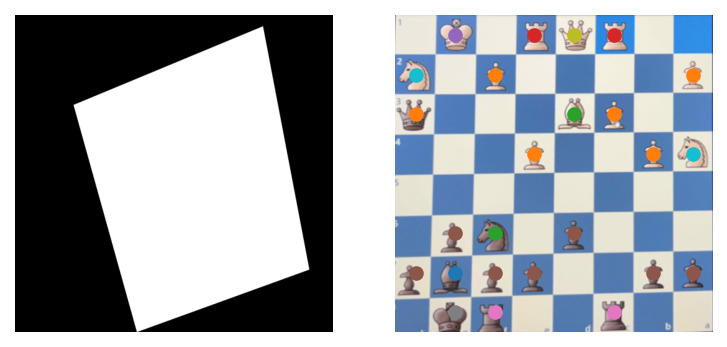

[[ 0  4  0  3  8  3  0  0]
 [ 9  0  1  0  0  0  0  1]
 [11  0  0  0  2  1  0  0]
 [ 0  0  0  1  0  0  1  9]
 [ 0  0  0  0  0  0  0  0]
 [ 0  5 12  0  5  0  0  0]
 [ 5 10  5  5  0  0  5  5]
 [ 0  7  6  0  0  6  0  0]]
54.png


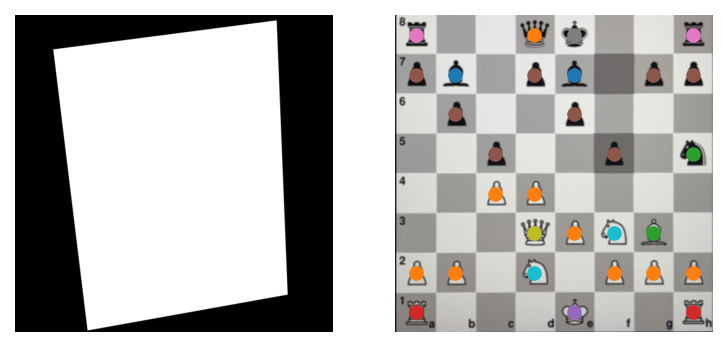

[[ 6  0  0 11  7  0  0  6]
 [ 5 10  0  5 10  0  5  5]
 [ 0  5  0  0  5  0  0  0]
 [ 0  0  5  0  0  5  0 12]
 [ 0  0  1  1  0  0  0  0]
 [ 0  0  0  8  1  9  2  0]
 [ 1  1  0  9  0  1  1  1]
 [ 3  0  0  0  4  0  0  3]]
12.png


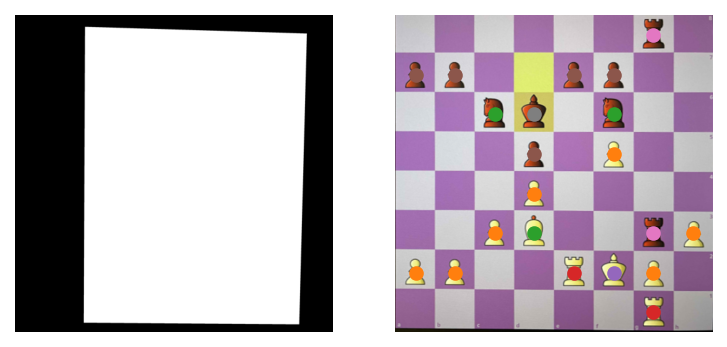

[[ 0  0  0  0  0  0  6  0]
 [ 5  5  0  0  5  5  0  0]
 [ 0  0 12  7  0 12  0  0]
 [ 0  0  0  5  0  1  0  0]
 [ 0  0  0  1  0  0  0  0]
 [ 0  0  1  2  0  0  6  1]
 [ 1  1  0  0  3  4  1  0]
 [ 0  0  0  0  0  0  3  0]]
53.png


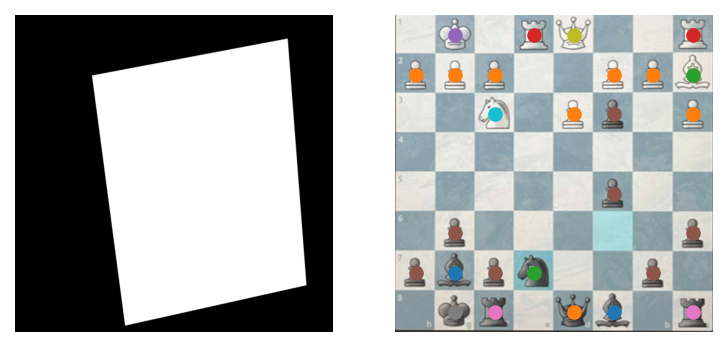

[[ 0  4  0  3  8  0  0  3]
 [ 1  1  1  0  0  1  1  2]
 [ 0  0  9  0  1  5  0  1]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  5  0  0]
 [ 0  5  0  0  0  0  0  5]
 [ 5 10  5 12  0  0  5  0]
 [ 0  7  6  0 11 10  0  6]]
6.png


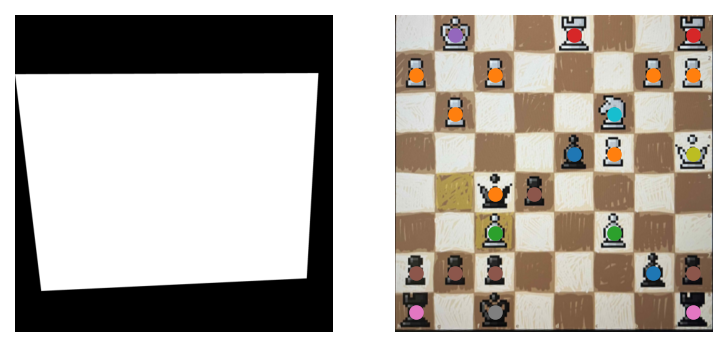

[[ 0  4  0  0  3  0  0  3]
 [ 1  0  1  0  0  0  1  1]
 [ 0  1  0  0  0  9  0  0]
 [ 0  0  0  0 10  1  0  8]
 [ 0  0 11  5  0  0  0  0]
 [ 0  0  2  0  0  2  0  0]
 [ 5  5  5  0  0  0 10  5]
 [ 6  0  7  0  0  0  0  6]]
27.png


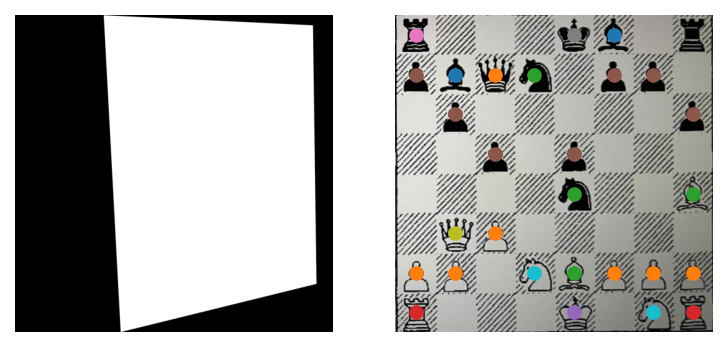

[[ 6  0  0  0  7 10  0  0]
 [ 5 10 11 12  0  5  5  0]
 [ 0  5  0  0  0  0  0  5]
 [ 0  0  5  0  5  0  0  0]
 [ 0  0  0  0 12  0  0  2]
 [ 0  8  1  0  0  0  0  0]
 [ 1  1  0  9  2  1  1  1]
 [ 3  0  0  0  4  0  9  3]]
14.png


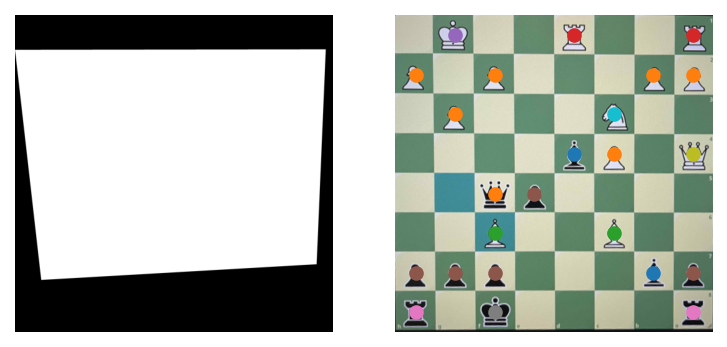

[[ 0  4  0  0  3  0  0  3]
 [ 1  0  1  0  0  0  1  1]
 [ 0  1  0  0  0  9  0  0]
 [ 0  0  0  0 10  1  0  8]
 [ 0  0 11  5  0  0  0  0]
 [ 0  0  2  0  0  2  0  0]
 [ 5  5  5  0  0  0 10  5]
 [ 6  0  7  0  0  0  0  6]]
86.png


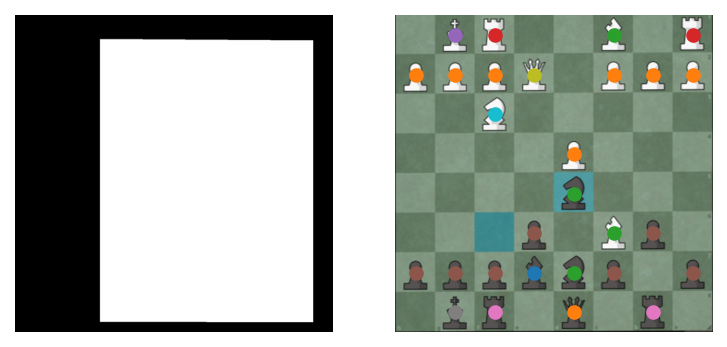

[[ 0  4  3  0  0  2  0  3]
 [ 1  1  1  8  0  1  1  1]
 [ 0  0  9  0  0  0  0  0]
 [ 0  0  0  0  1  0  0  0]
 [ 0  0  0  0 12  0  0  0]
 [ 0  0  0  5  0  2  5  0]
 [ 5  5  5 10 12  5  0  5]
 [ 0  7  6  0 11  0  6  0]]
78.png


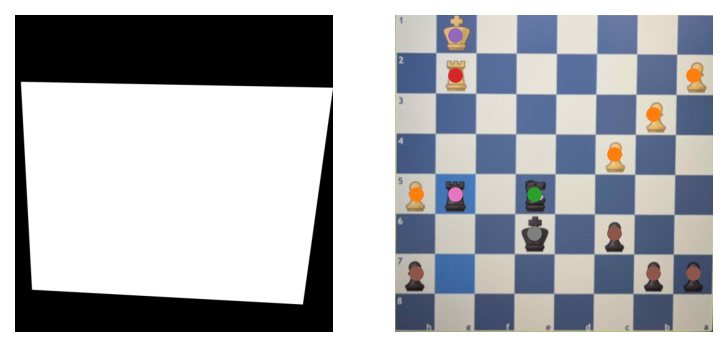

[[ 0  4  0  0  0  0  0  0]
 [ 0  3  0  0  0  0  0  1]
 [ 0  0  0  0  0  0  1  0]
 [ 0  0  0  0  0  1  0  0]
 [ 1  6  0 12  0  0  0  0]
 [ 0  0  0  7  0  5  0  0]
 [ 5  0  0  0  0  0  5  5]
 [ 0  0  0  0  0  0  0  0]]
45.png


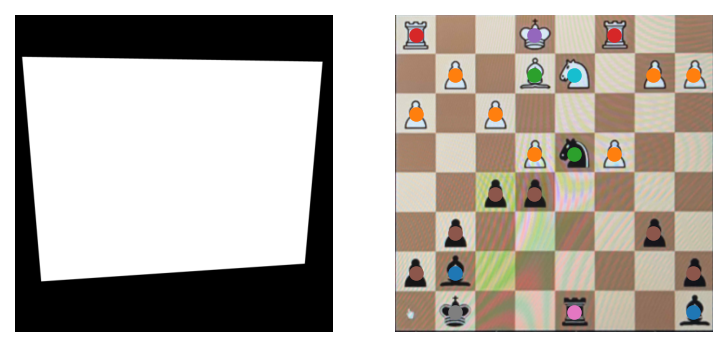

[[ 3  0  0  4  0  3  0  0]
 [ 0  1  0  2  9  0  1  1]
 [ 1  0  1  0  0  0  0  0]
 [ 0  0  0  1 12  1  0  0]
 [ 0  0  5  5  0  0  0  0]
 [ 0  5  0  0  0  0  5  0]
 [ 5 10  0  0  0  0  0  5]
 [ 0  7  0  0  6  0  0 10]]
8.png


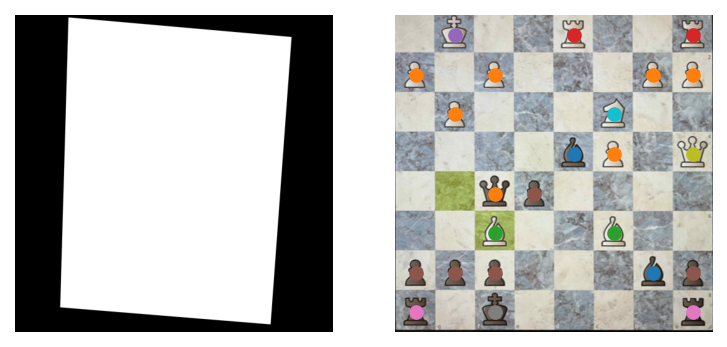

[[ 0  4  0  0  3  0  0  3]
 [ 1  0  1  0  0  0  1  1]
 [ 0  1  0  0  0  9  0  0]
 [ 0  0  0  0 10  1  0  8]
 [ 0  0 11  5  0  0  0  0]
 [ 0  0  2  0  0  2  0  0]
 [ 5  5  5  0  0  0 10  5]
 [ 6  0  7  0  0  0  0  6]]
23.png


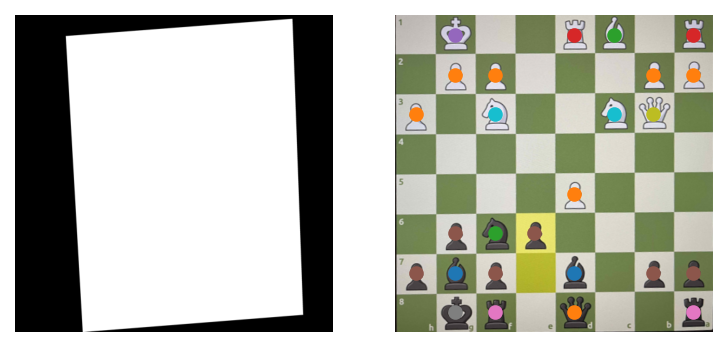

[[ 0  4  0  0  3  2  0  3]
 [ 0  1  1  0  0  0  1  1]
 [ 1  0  9  0  0  9  8  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  1  0  0  0]
 [ 0  5 12  5  0  0  0  0]
 [ 5 10  5  0 10  0  5  5]
 [ 0  7  6  0 11  0  0  6]]
47.png


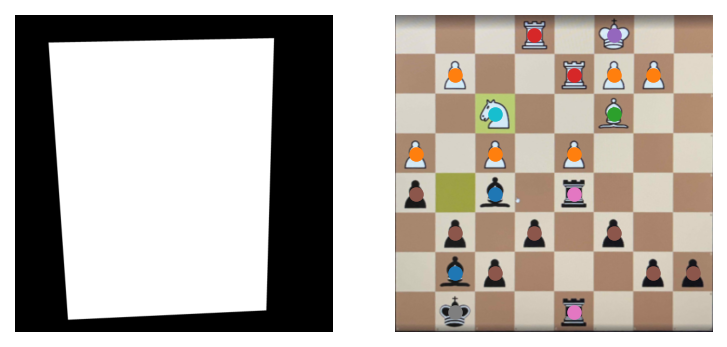

[[ 0  0  0  3  0  4  0  0]
 [ 0  1  0  0  3  1  1  0]
 [ 0  0  9  0  0  2  0  0]
 [ 1  0  1  0  1  0  0  0]
 [ 5  0 10  0  6  0  0  0]
 [ 0  5  0  5  0  5  0  0]
 [ 0 10  5  0  0  0  5  5]
 [ 0  7  0  0  6  0  0  0]]
82.png


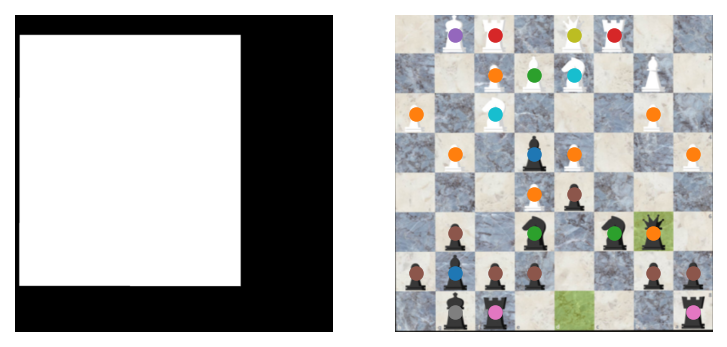

[[ 0  4  3  0  8  3  0  0]
 [ 0  0  1  2  9  0  0  0]
 [ 1  0  9  0  0  0  1  0]
 [ 0  1  0 10  1  0  0  1]
 [ 0  0  0  1  5  0  0  0]
 [ 0  5  0 12  0 12 11  0]
 [ 5 10  5  5  0  0  5  5]
 [ 0  7  6  0  0  0  0  6]]
67.png


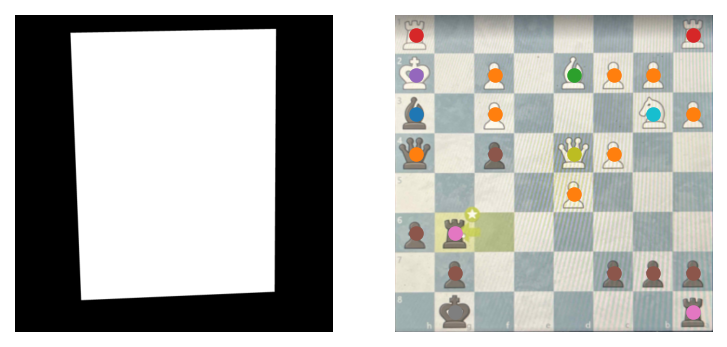

[[ 3  0  0  0  0  0  0  3]
 [ 4  0  1  0  2  1  1  0]
 [10  0  1  0  0  0  9  1]
 [11  0  5  0  8  1  0  0]
 [ 0  0  0  0  1  0  0  0]
 [ 5  6  0  0  0  0  0  0]
 [ 0  5  0  0  0  5  5  5]
 [ 0  7  0  0  0  0  0  6]]
43.png


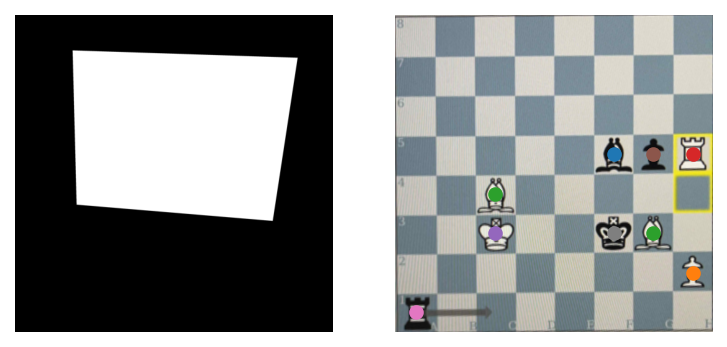

[[ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 10  5  3]
 [ 0  0  2  0  0  0  0  0]
 [ 0  0  4  0  0  7  2  0]
 [ 0  0  0  0  0  0  0  1]
 [ 6  0  0  0  0  0  0  0]]
94.png


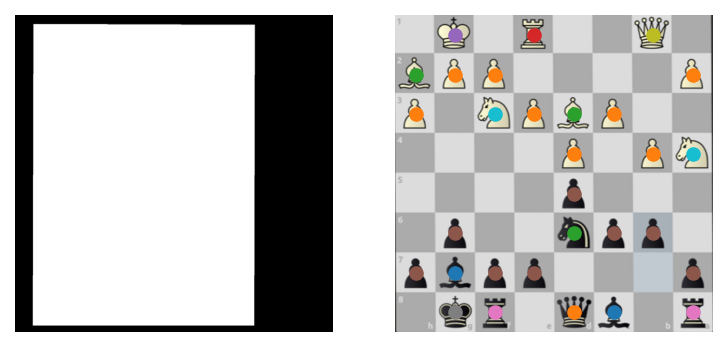

[[ 0  4  0  3  0  0  8  0]
 [ 2  1  1  0  0  0  0  1]
 [ 1  0  9  1  2  1  0  0]
 [ 0  0  0  0  1  0  1  9]
 [ 0  0  0  0  5  0  0  0]
 [ 0  5  0  0 12  5  5  0]
 [ 5 10  5  5  0  0  0  5]
 [ 0  7  6  0 11 10  0  6]]
29.png


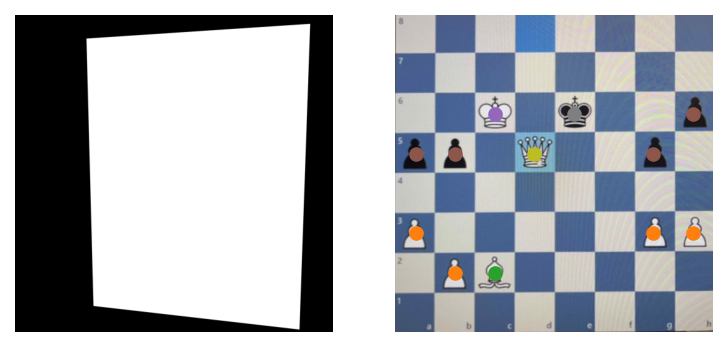

[[0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0]
 [0 0 4 0 7 0 0 5]
 [5 5 0 8 0 0 5 0]
 [0 0 0 0 0 0 0 0]
 [1 0 0 0 0 0 1 1]
 [0 1 2 0 0 0 0 0]
 [0 0 0 0 0 0 0 0]]
66.png


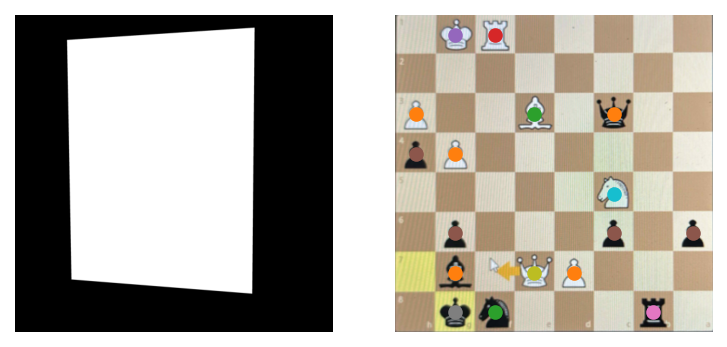

[[ 0  4  3  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 1  0  0  2  0 11  0  0]
 [ 5  1  0  0  0  0  0  0]
 [ 0  0  0  0  0  9  0  0]
 [ 0  5  0  0  0  5  0  5]
 [ 0 11  0  8  1  0  0  0]
 [ 0  7 12  0  0  0  6  0]]
2.png


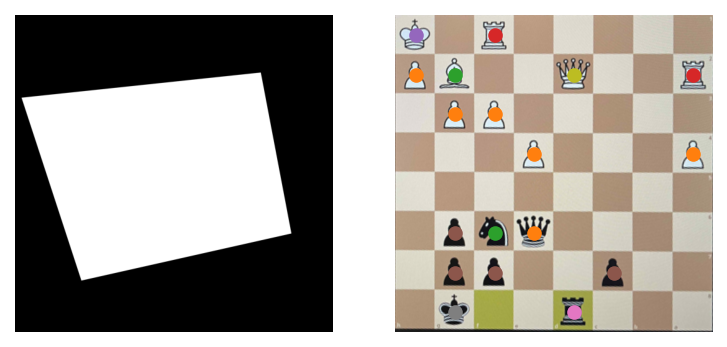

[[ 4  0  3  0  0  0  0  0]
 [ 1  2  0  0  8  0  0  3]
 [ 0  1  1  0  0  0  0  0]
 [ 0  0  0  1  0  0  0  1]
 [ 0  0  0  0  0  0  0  0]
 [ 0  5 12 11  0  0  0  0]
 [ 0  5  5  0  0  5  0  0]
 [ 0  7  0  0  6  0  0  0]]
26.png


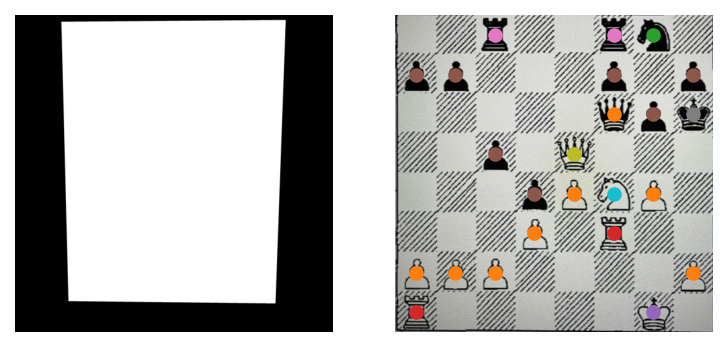

[[ 0  0  6  0  0  6 12  0]
 [ 5  5  0  0  0  5  0  5]
 [ 0  0  0  0  0 11  5  7]
 [ 0  0  5  0  8  0  0  0]
 [ 0  0  0  5  1  9  1  0]
 [ 0  0  0  1  0  3  0  0]
 [ 1  1  1  0  0  0  0  1]
 [ 3  0  0  0  0  0  4  0]]
46.png


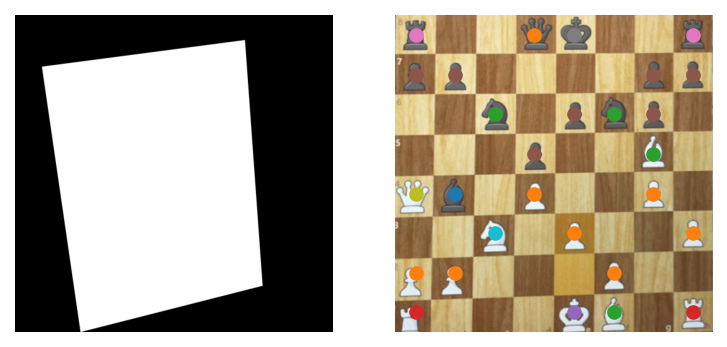

[[ 6  0  0 11  7  0  0  6]
 [ 5  5  0  0  0  0  5  5]
 [ 0  0 12  0  5 12  5  0]
 [ 0  0  0  5  0  0  2  0]
 [ 8 10  0  1  0  0  1  0]
 [ 0  0  9  0  1  0  0  1]
 [ 1  1  0  0  0  1  0  0]
 [ 3  0  0  0  4  2  0  3]]
15.png


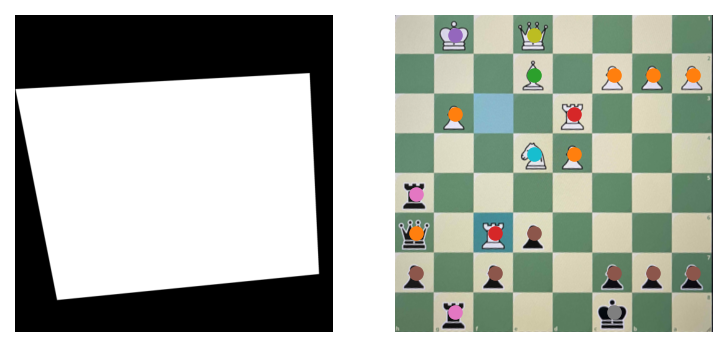

[[ 0  4  0  8  0  0  0  0]
 [ 0  0  0  2  0  1  1  1]
 [ 0  1  0  0  3  0  0  0]
 [ 0  0  0  9  1  0  0  0]
 [ 6  0  0  0  0  0  0  0]
 [11  0  3  5  0  0  0  0]
 [ 5  0  5  0  0  5  5  5]
 [ 0  6  0  0  0  7  0  0]]
92.png


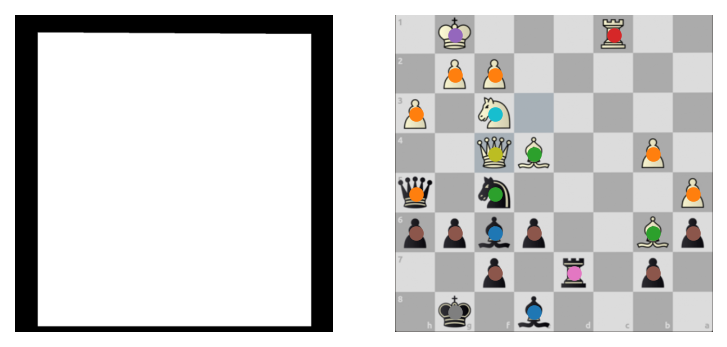

[[ 0  4  0  0  0  3  0  0]
 [ 0  1  1  0  0  0  0  0]
 [ 1  0  9  0  0  0  0  0]
 [ 0  0  8  2  0  0  1  0]
 [11  0 12  0  0  0  0  1]
 [ 5  5 10  5  0  0  2  5]
 [ 0  0  5  0  6  0  5  0]
 [ 0  7  0 10  0  0  0  0]]
79.png


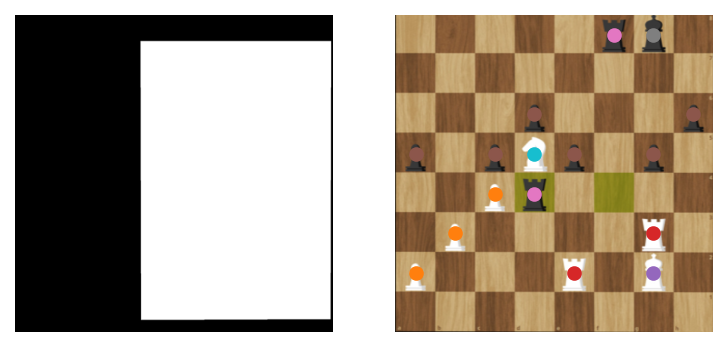

[[0 0 0 0 0 6 7 0]
 [0 0 0 0 0 0 0 0]
 [0 0 0 5 0 0 0 5]
 [5 0 5 9 5 0 5 0]
 [0 0 1 6 0 0 0 0]
 [0 1 0 0 0 0 3 0]
 [1 0 0 0 3 0 4 0]
 [0 0 0 0 0 0 0 0]]
49.png


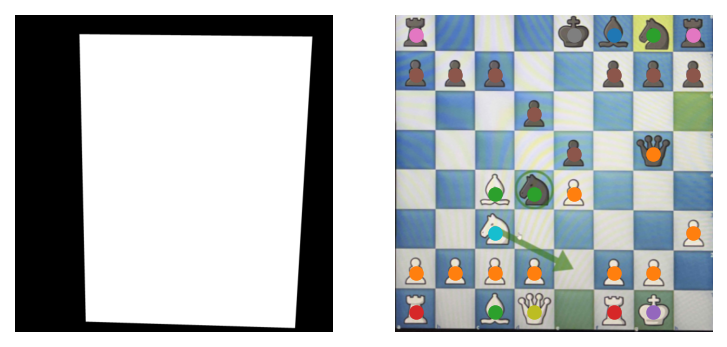

[[ 6  0  0  0  7 10 12  6]
 [ 5  5  5  0  0  5  5  5]
 [ 0  0  0  5  0  0  0  0]
 [ 0  0  0  0  5  0 11  0]
 [ 0  0  2 12  1  0  0  0]
 [ 0  0  9  0  0  0  0  1]
 [ 1  1  1  1  0  1  1  0]
 [ 3  0  2  8  0  3  4  0]]
74.png


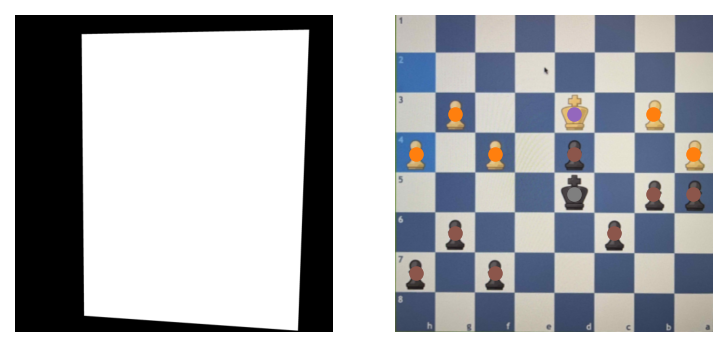

[[0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0]
 [0 1 0 0 4 0 1 0]
 [1 0 1 0 5 0 0 1]
 [0 0 0 0 7 0 5 5]
 [0 5 0 0 0 5 0 0]
 [5 0 5 0 0 0 0 0]
 [0 0 0 0 0 0 0 0]]
13.png


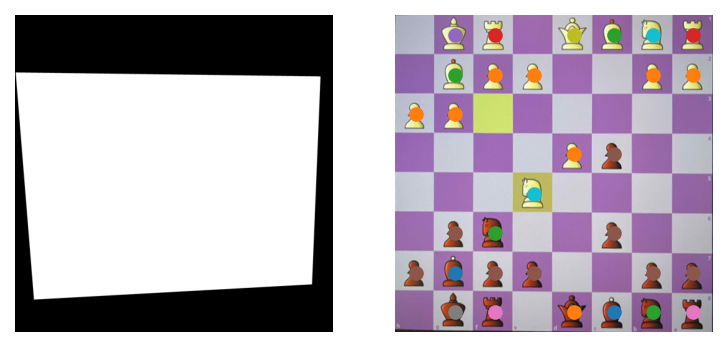

[[ 0  4  3  0  8  2  9  3]
 [ 0  2  1  1  0  0  1  1]
 [ 1  1  0  0  0  0  0  0]
 [ 0  0  0  0  1  5  0  0]
 [ 0  0  0  9  0  0  0  0]
 [ 0  5 12  0  0  5  0  0]
 [ 5 10  5  5  0  0  5  5]
 [ 0  7  6  0 11 10 12  6]]
62.png


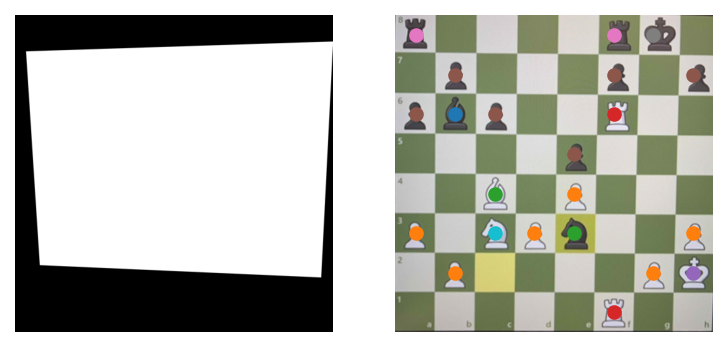

[[ 6  0  0  0  0  6  7  0]
 [ 0  5  0  0  0  5  0  5]
 [ 5 10  5  0  0  3  0  0]
 [ 0  0  0  0  5  0  0  0]
 [ 0  0  2  0  1  0  0  0]
 [ 1  0  9  1 12  0  0  1]
 [ 0  1  0  0  0  0  1  4]
 [ 0  0  0  0  0  3  0  0]]
87.png


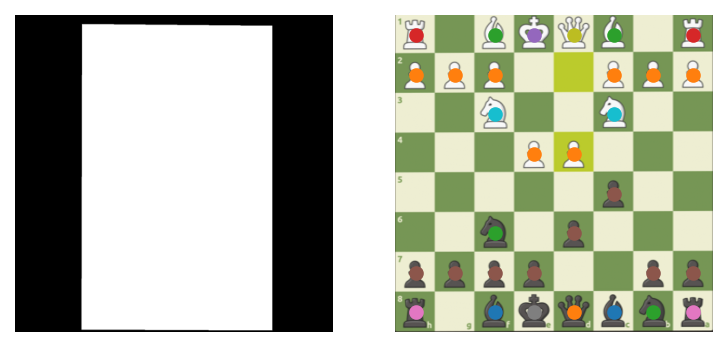

[[ 3  0  2  4  8  2  0  3]
 [ 1  1  1  0  0  1  1  1]
 [ 0  0  9  0  0  9  0  0]
 [ 0  0  0  1  1  0  0  0]
 [ 0  0  0  0  0  5  0  0]
 [ 0  0 12  0  5  0  0  0]
 [ 5  5  5  5  0  0  5  5]
 [ 6  0 10  7 11 10 12  6]]
81.png


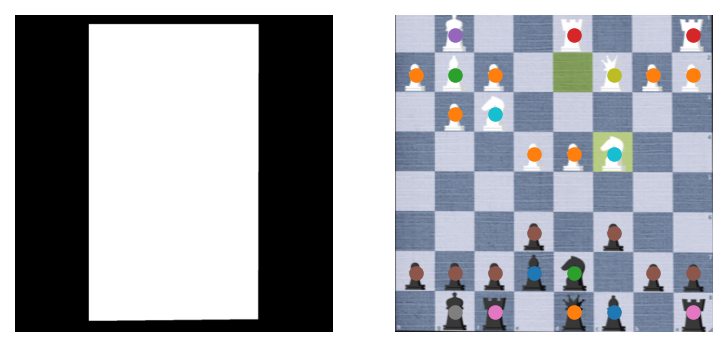

[[ 0  4  0  0  3  0  0  3]
 [ 1  2  1  0  0  8  1  1]
 [ 0  1  9  0  0  0  0  0]
 [ 0  0  0  1  1  9  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  5  0  5  0  0]
 [ 5  5  5 10 12  0  5  5]
 [ 0  7  6  0 11 10  0  6]]
34.png


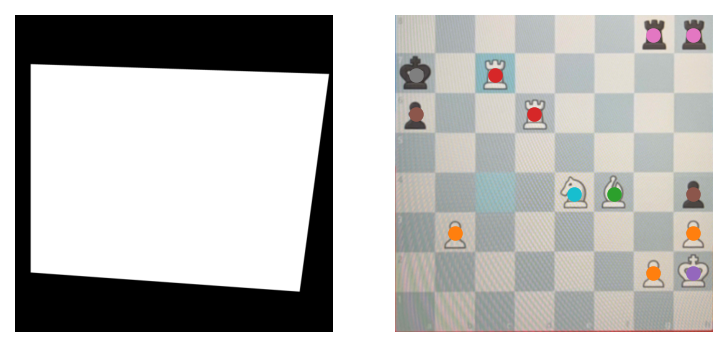

[[0 0 0 0 0 0 6 6]
 [7 0 3 0 0 0 0 0]
 [5 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 0 0]
 [0 0 0 0 9 2 0 5]
 [0 1 0 0 0 0 0 1]
 [0 0 0 0 0 0 1 4]
 [0 0 0 0 0 0 0 0]]
22.png


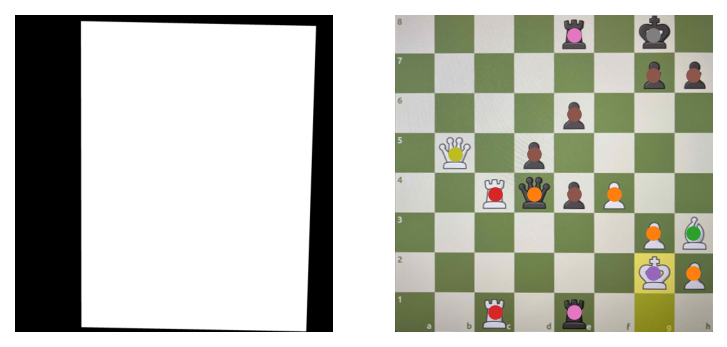

[[ 0  0  0  0  6  0  7  0]
 [ 0  0  0  0  0  0  5  5]
 [ 0  0  0  0  5  0  0  0]
 [ 0  8  0  5  0  0  0  0]
 [ 0  0  3 11  5  1  0  0]
 [ 0  0  0  0  0  0  1  2]
 [ 0  0  0  0  0  0  4  1]
 [ 0  0  3  0  6  0  0  0]]
85.png


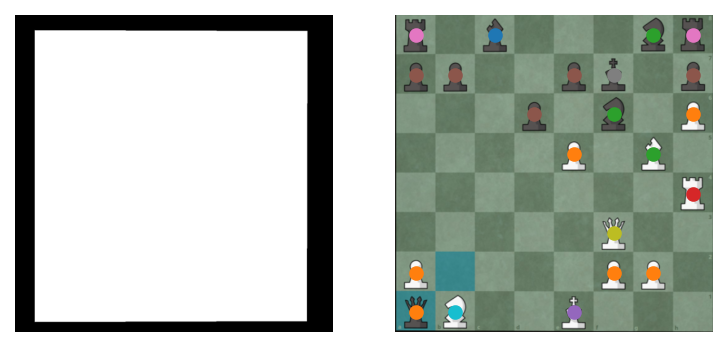

[[ 6  0 10  0  0  0 12  6]
 [ 5  5  0  0  5  7  0  5]
 [ 0  0  0  5  0 12  0  1]
 [ 0  0  0  0  1  0  2  0]
 [ 0  0  0  0  0  0  0  3]
 [ 0  0  0  0  0  8  0  0]
 [ 1  0  0  0  0  1  1  0]
 [11  9  0  0  4  0  0  0]]
80.png


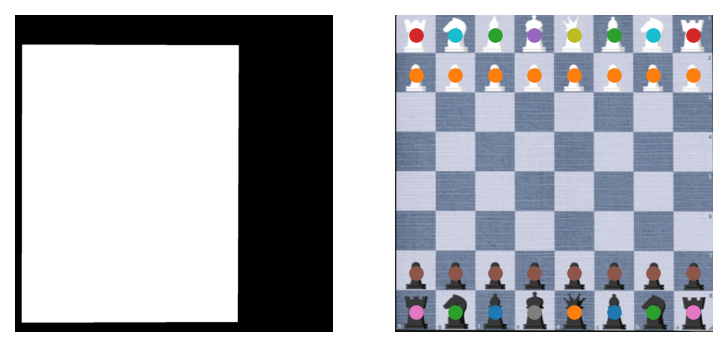

[[ 3  9  2  4  8  2  9  3]
 [ 1  1  1  1  1  1  1  1]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 5  5  5  5  5  5  5  5]
 [ 6 12 10  7 11 10 12  6]]
28.png


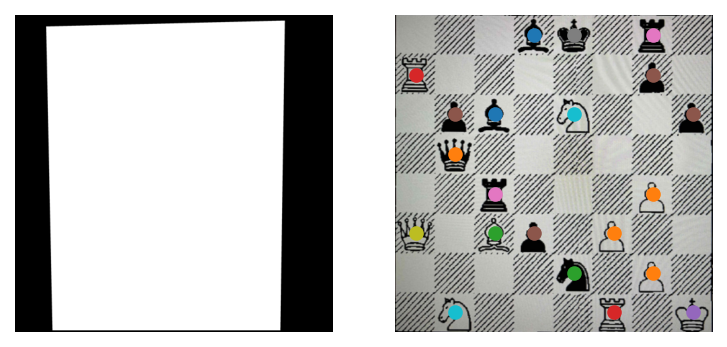

[[ 0  0  0 10  7  0  6  0]
 [ 3  0  0  0  0  0  5  0]
 [ 0  5 10  0  9  0  0  5]
 [ 0 11  0  0  0  0  0  0]
 [ 0  0  6  0  0  0  1  0]
 [ 8  0  2  5  0  1  0  0]
 [ 0  0  0  0 12  0  1  0]
 [ 0  9  0  0  0  3  0  4]]
51.png


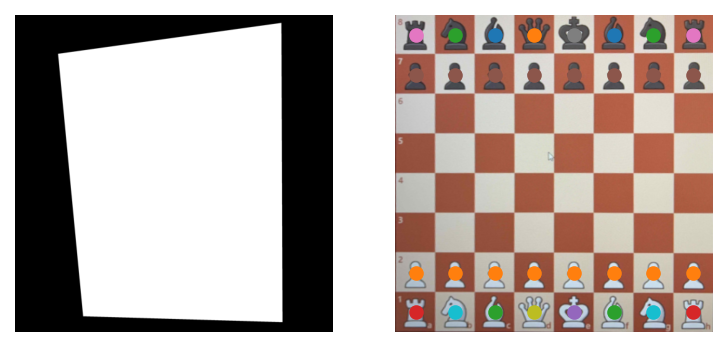

[[ 6 12 10 11  7 10 12  6]
 [ 5  5  5  5  5  5  5  5]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 1  1  1  1  1  1  1  1]
 [ 3  9  2  8  4  2  9  3]]
64.png


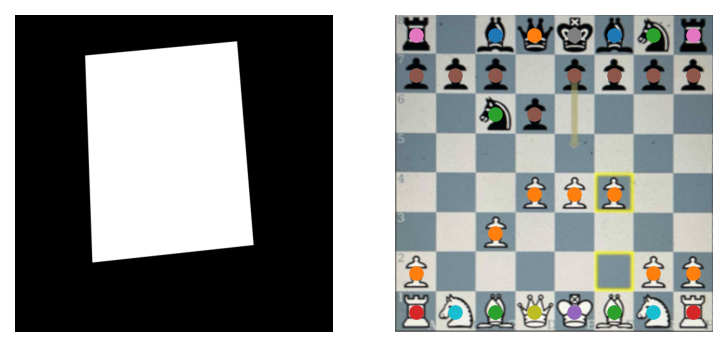

[[ 6  0 10 11  7 10 12  6]
 [ 5  5  5  0  5  5  5  5]
 [ 0  0 12  5  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  1  1  1  0  0]
 [ 0  0  1  0  0  0  0  0]
 [ 1  0  0  0  0  0  1  1]
 [ 3  9  2  8  4  2  9  3]]
69.png


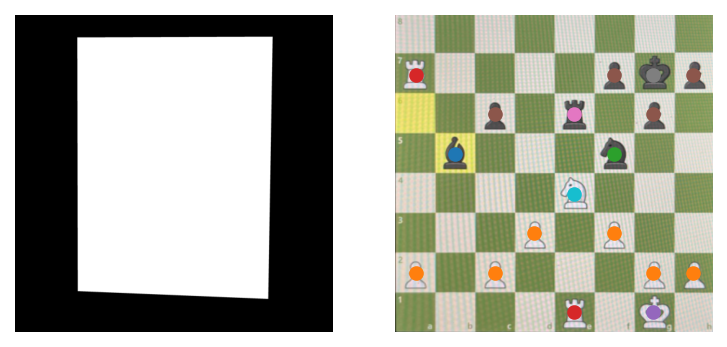

[[ 0  0  0  0  0  0  0  0]
 [ 3  0  0  0  0  5  7  5]
 [ 0  0  5  0  6  0  5  0]
 [ 0 10  0  0  0 12  0  0]
 [ 0  0  0  0  9  0  0  0]
 [ 0  0  0  1  0  1  0  0]
 [ 1  0  1  0  0  0  1  1]
 [ 0  0  0  0  3  0  4  0]]
24.png


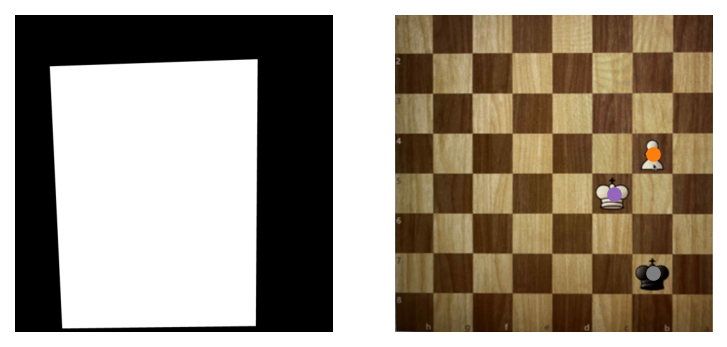

[[0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 1 0]
 [0 0 0 0 0 4 0 0]
 [0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 7 0]
 [0 0 0 0 0 0 0 0]]
44.png


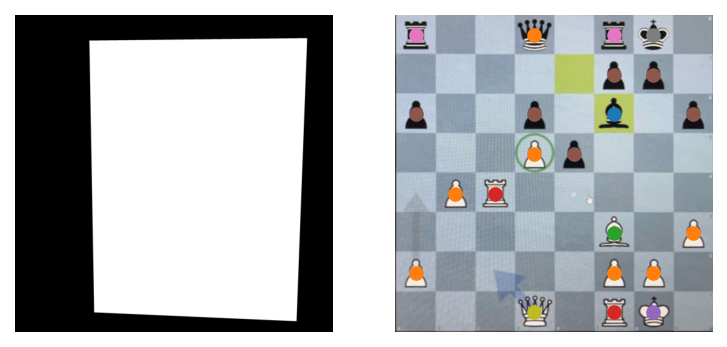

[[ 6  0  0 11  0  6  7  0]
 [ 0  0  0  0  0  5  5  0]
 [ 5  0  0  5  0 10  0  5]
 [ 0  0  0  1  5  0  0  0]
 [ 0  1  3  0  0  0  0  0]
 [ 0  0  0  0  0  2  0  1]
 [ 1  0  0  0  0  1  1  0]
 [ 0  0  0  8  0  3  4  0]]
37.png


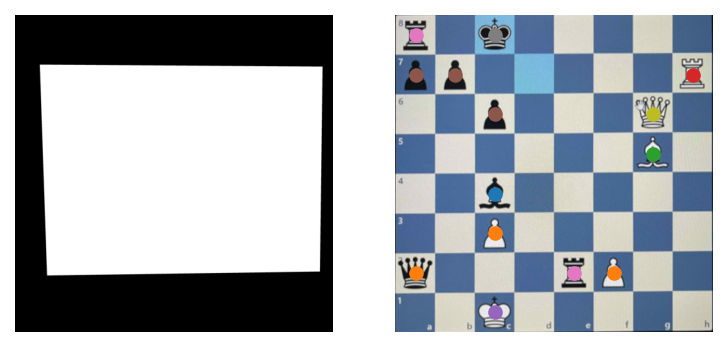

[[ 6  0  7  0  0  0  0  0]
 [ 5  5  0  0  0  0  0  3]
 [ 0  0  5  0  0  0  8  0]
 [ 0  0  0  0  0  0  2  0]
 [ 0  0 10  0  0  0  0  0]
 [ 0  0  1  0  0  0  0  0]
 [11  0  0  0  6  1  0  0]
 [ 0  0  4  0  0  0  0  0]]
61.png


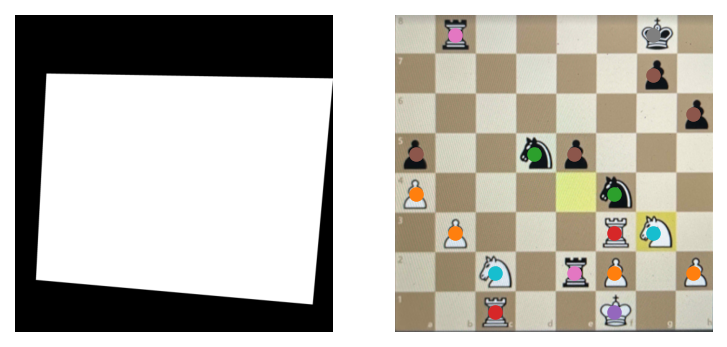

[[ 0  6  0  0  0  0  7  0]
 [ 0  0  0  0  0  0  5  0]
 [ 0  0  0  0  0  0  0  5]
 [ 5  0  0 12  5  0  0  0]
 [ 1  0  0  0  0 12  0  0]
 [ 0  1  0  0  0  3  9  0]
 [ 0  0  9  0  6  1  0  1]
 [ 0  0  3  0  0  4  0  0]]
57.png


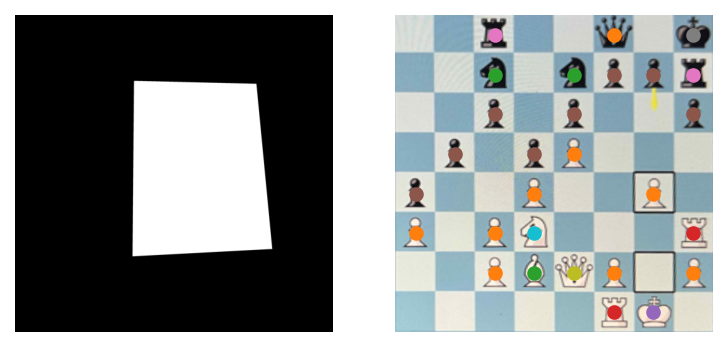

[[ 0  0  6  0  0 11  0  7]
 [ 0  0 12  0 12  5  5  6]
 [ 0  0  5  0  5  0  0  5]
 [ 0  5  0  5  1  0  0  0]
 [ 5  0  0  1  0  0  1  0]
 [ 1  0  1  9  0  0  0  3]
 [ 0  0  1  2  8  1  0  1]
 [ 0  0  0  0  0  3  4  0]]
77.png


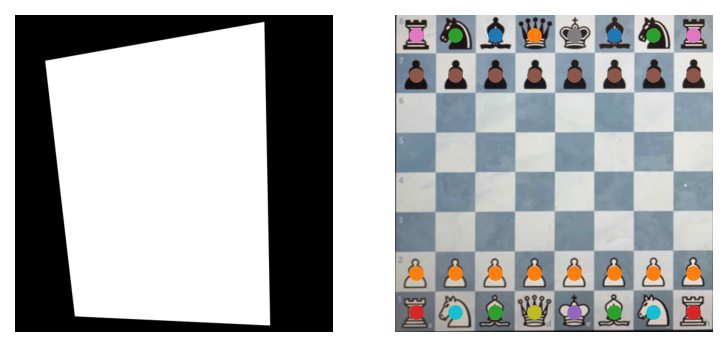

[[ 6 12 10 11  7 10 12  6]
 [ 5  5  5  5  5  5  5  5]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 1  1  1  1  1  1  1  1]
 [ 3  9  2  8  4  2  9  3]]
65.png


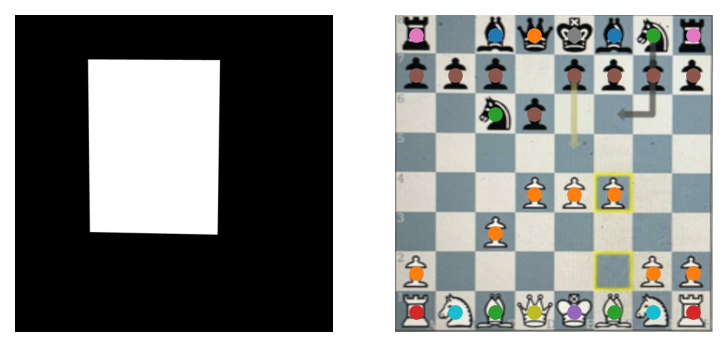

[[ 6  0 10 11  7 10 12  6]
 [ 5  5  5  0  5  5  5  5]
 [ 0  0 12  5  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  1  1  1  0  0]
 [ 0  0  1  0  0  0  0  0]
 [ 1  0  0  0  0  0  1  1]
 [ 3  9  2  8  4  2  9  3]]
88.png


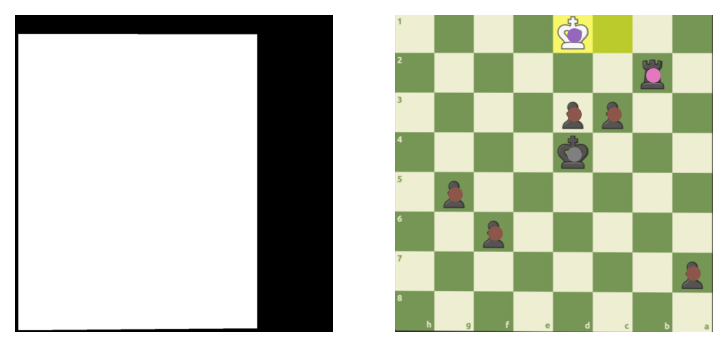

[[0 0 0 0 4 0 0 0]
 [0 0 0 0 0 0 6 0]
 [0 0 0 0 5 5 0 0]
 [0 0 0 0 7 0 0 0]
 [0 5 0 0 0 0 0 0]
 [0 0 5 0 0 0 0 0]
 [0 0 0 0 0 0 0 5]
 [0 0 0 0 0 0 0 0]]
21.png


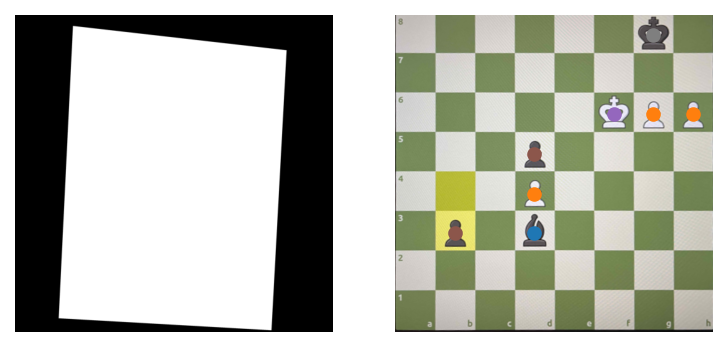

[[ 0  0  0  0  0  0  7  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  4  1  1]
 [ 0  0  0  5  0  0  0  0]
 [ 0  0  0  1  0  0  0  0]
 [ 0  5  0 10  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]]
72.png


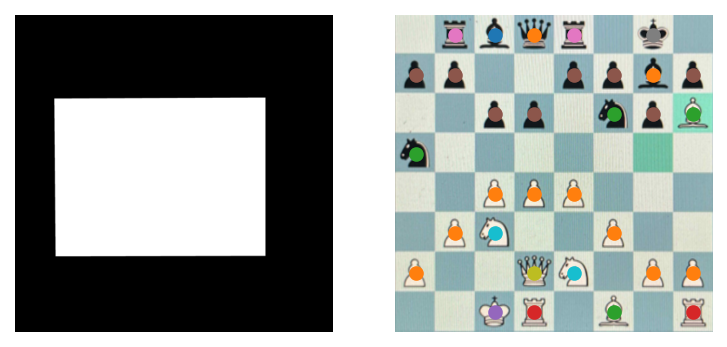

[[ 0  6 10 11  6  0  7  0]
 [ 5  5  0  0  5  5 11  5]
 [ 0  0  5  5  0 12  5  2]
 [12  0  0  0  0  0  0  0]
 [ 0  0  1  1  1  0  0  0]
 [ 0  1  9  0  0  1  0  0]
 [ 1  0  0  8  9  0  1  1]
 [ 0  0  4  3  0  2  0  3]]
35.png


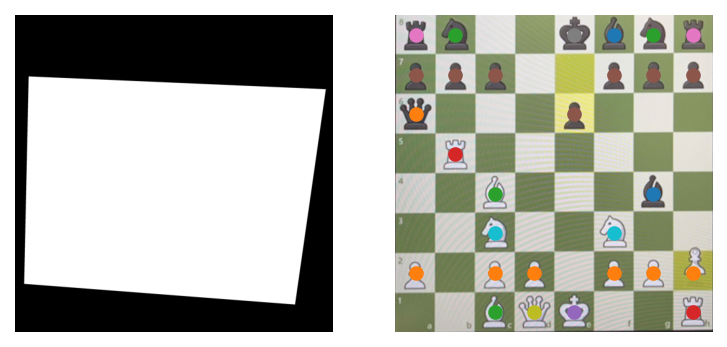

[[ 6 12  0  0  7 10 12  6]
 [ 5  5  5  0  0  5  5  5]
 [11  0  0  0  5  0  0  0]
 [ 0  3  0  0  0  0  0  0]
 [ 0  0  2  0  0  0 10  0]
 [ 0  0  9  0  0  9  0  0]
 [ 1  0  1  1  0  1  1  1]
 [ 0  0  2  8  4  0  0  3]]
19.png


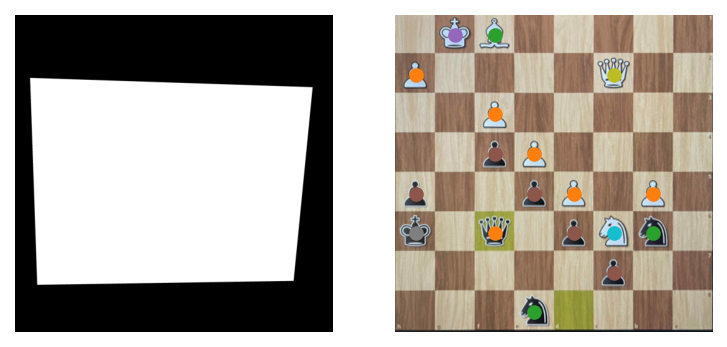

[[ 0  4  2  0  0  0  0  0]
 [ 1  0  0  0  0  8  0  0]
 [ 0  0  1  0  0  0  0  0]
 [ 0  0  5  1  0  0  0  0]
 [ 5  0  0  5  1  0  1  0]
 [ 7  0 11  0  5  9 12  0]
 [ 0  0  0  0  0  5  0  0]
 [ 0  0  0 12  0  0  0  0]]
40.png


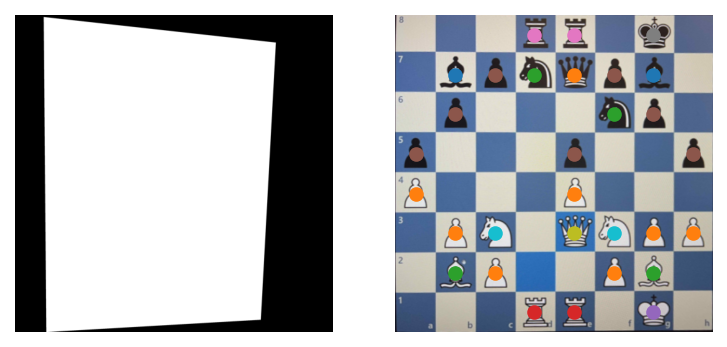

[[ 0  0  0  6  6  0  7  0]
 [ 0 10  5 12 11  5 10  0]
 [ 0  5  0  0  0 12  5  0]
 [ 5  0  0  0  5  0  0  5]
 [ 1  0  0  0  1  0  0  0]
 [ 0  1  9  0  8  9  1  1]
 [ 0  2  1  0  0  1  2  0]
 [ 0  0  0  3  3  0  4  0]]
60.png


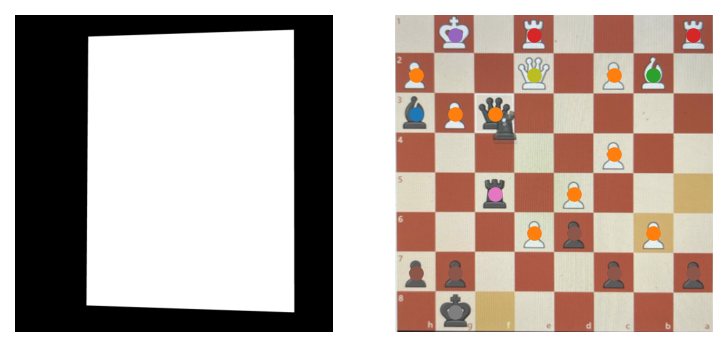

[[ 0  4  0  3  0  0  0  3]
 [ 1  0  0  8  0  1  2  0]
 [10  1 11  0  0  0  0  0]
 [ 0  0  0  0  0  1  0  0]
 [ 0  0  6  0  1  0  0  0]
 [ 0  0  0  1  5  0  1  0]
 [ 5  5  0  0  0  5  0  5]
 [ 0  7  0  0  0  0  0  0]]
83.png


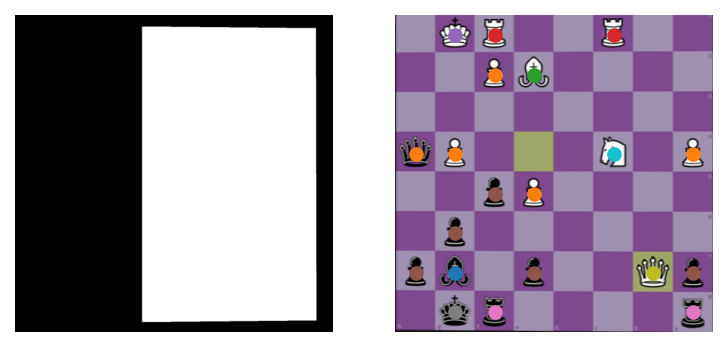

[[ 0  4  3  0  0  3  0  0]
 [ 0  0  1  2  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [11  1  0  0  0  9  0  1]
 [ 0  0  5  1  0  0  0  0]
 [ 0  5  0  0  0  0  0  0]
 [ 5 10  0  5  0  0  8  5]
 [ 0  7  6  0  0  0  0  6]]
76.png


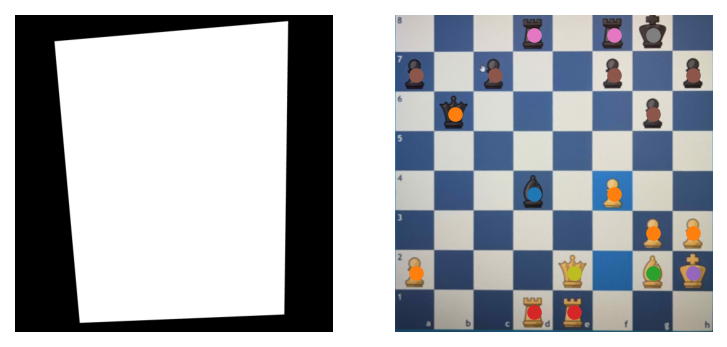

[[ 0  0  0  6  0  6  7  0]
 [ 5  0  5  0  0  5  0  5]
 [ 0 11  0  0  0  0  5  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0 10  0  1  0  0]
 [ 0  0  0  0  0  0  1  1]
 [ 1  0  0  0  8  0  2  4]
 [ 0  0  0  3  3  0  0  0]]
68.png


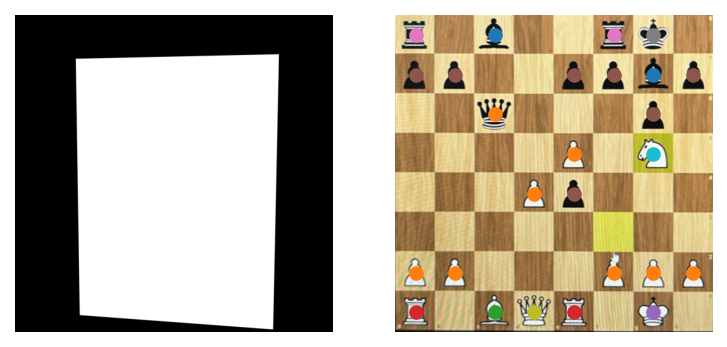

[[ 6  0 10  0  0  6  7  0]
 [ 5  5  0  0  5  5 10  5]
 [ 0  0 11  0  0  0  5  0]
 [ 0  0  0  0  1  0  9  0]
 [ 0  0  0  1  5  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 1  1  0  0  0  1  1  1]
 [ 3  0  2  8  3  0  4  0]]
18.png


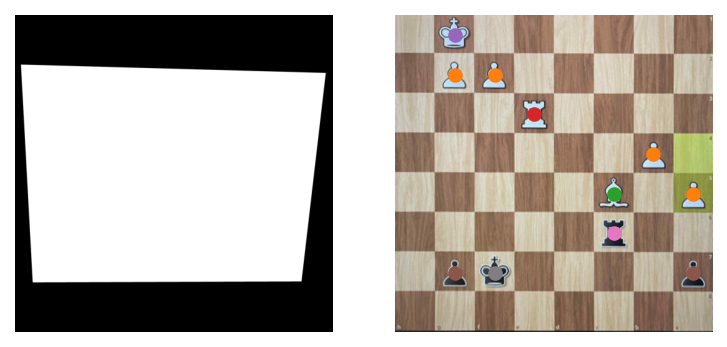

[[0 4 0 0 0 0 0 0]
 [0 1 1 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0]
 [0 0 0 0 0 2 0 1]
 [0 0 0 0 0 6 0 0]
 [0 5 7 0 0 0 0 5]
 [0 0 0 0 0 0 0 0]]
91.png


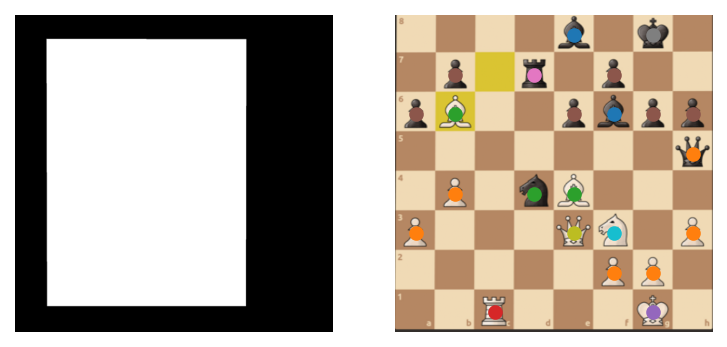

[[ 0  0  0  0 10  0  7  0]
 [ 0  5  0  6  0  5  0  0]
 [ 5  2  0  0  5 10  5  5]
 [ 0  0  0  0  0  0  0 11]
 [ 0  1  0 12  2  0  0  0]
 [ 1  0  0  0  8  9  0  1]
 [ 0  0  0  0  0  1  1  0]
 [ 0  0  3  0  0  0  4  0]]
89.png


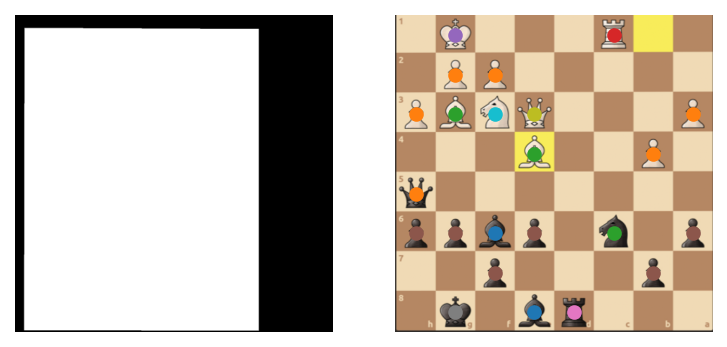

[[ 0  4  0  0  0  3  0  0]
 [ 0  1  1  0  0  0  0  0]
 [ 1  2  9  8  0  0  0  1]
 [ 0  0  0  2  0  0  1  0]
 [11  0  0  0  0  0  0  0]
 [ 5  5 10  5  0 12  0  5]
 [ 0  0  5  0  0  0  5  0]
 [ 0  7  0 10  6  0  0  0]]
1.png


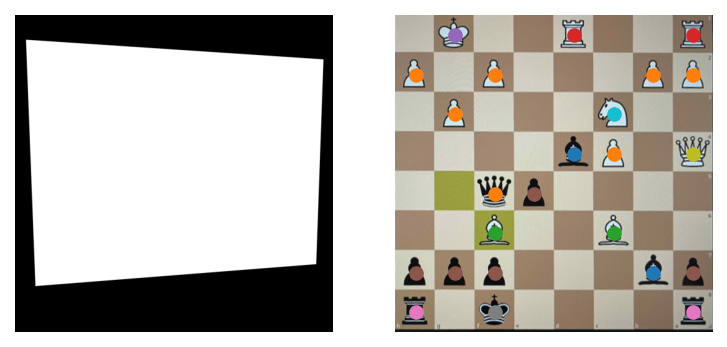

[[ 0  4  0  0  3  0  0  3]
 [ 1  0  1  0  0  0  1  1]
 [ 0  1  0  0  0  9  0  0]
 [ 0  0  0  0 10  1  0  8]
 [ 0  0 11  5  0  0  0  0]
 [ 0  0  2  0  0  2  0  0]
 [ 5  5  5  0  0  0 10  5]
 [ 6  0  7  0  0  0  0  6]]
5.png


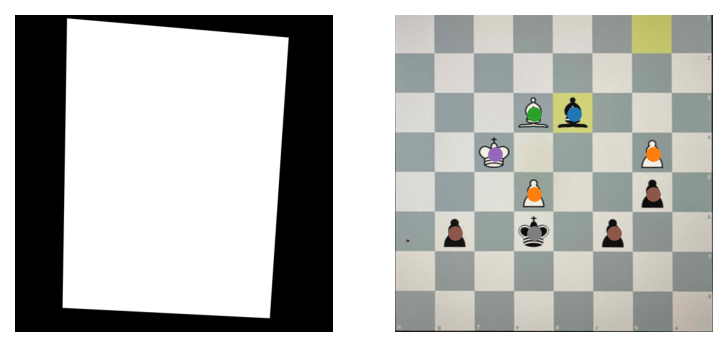

[[ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  2 10  0  0  0]
 [ 0  0  4  0  0  0  1  0]
 [ 0  0  0  1  0  0  5  0]
 [ 0  5  0  7  0  5  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]]
36.png


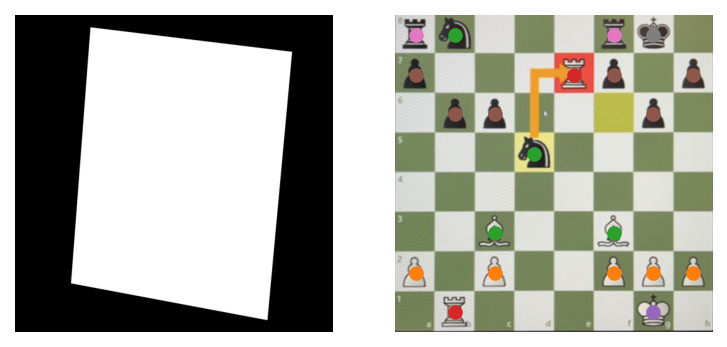

[[ 6 12  0  0  0  6  7  0]
 [ 5  0  0  0  3  5  0  5]
 [ 0  5  5  0  0  0  5  0]
 [ 0  0  0 12  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  2  0  0  2  0  0]
 [ 1  0  1  0  0  1  1  1]
 [ 0  3  0  0  0  0  4  0]]
17.png


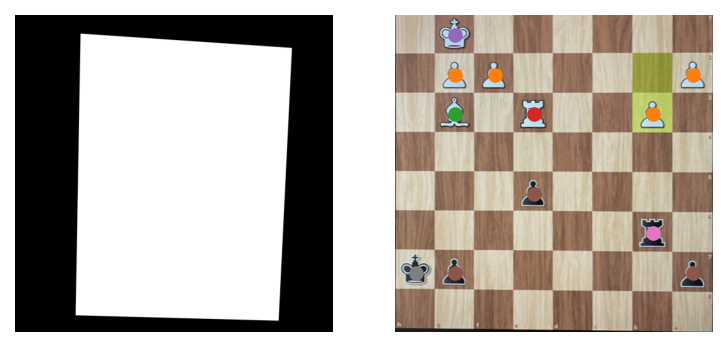

[[0 4 0 0 0 0 0 0]
 [0 1 1 0 0 0 0 1]
 [0 2 0 3 0 0 1 0]
 [0 0 0 0 0 0 0 0]
 [0 0 0 5 0 0 0 0]
 [0 0 0 0 0 0 6 0]
 [7 5 0 0 0 0 0 5]
 [0 0 0 0 0 0 0 0]]
3.png


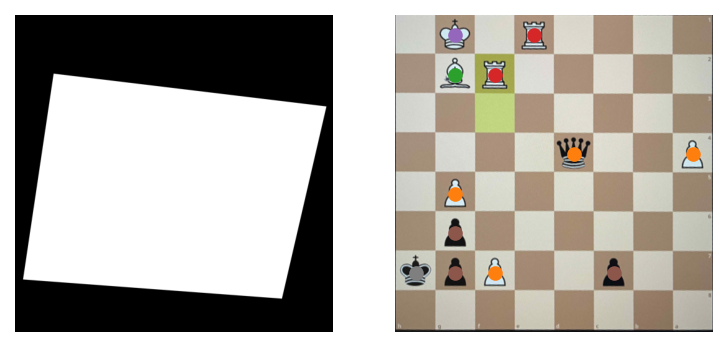

[[ 0  4  0  3  0  0  0  0]
 [ 0  2  3  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0 11  0  0  1]
 [ 0  1  0  0  0  0  0  0]
 [ 0  5  0  0  0  0  0  0]
 [ 7  5  1  0  0  5  0  0]
 [ 0  0  0  0  0  0  0  0]]
48.png


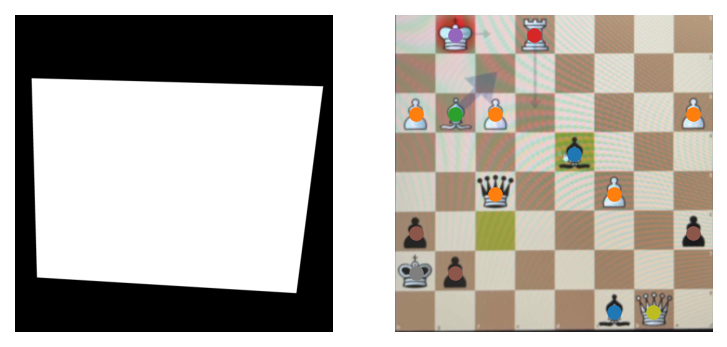

[[ 0  4  0  3  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 1  2  1  0  0  0  0  1]
 [ 0  0  0  0 10  0  0  0]
 [ 0  0 11  0  0  1  0  0]
 [ 5  0  0  0  0  0  0  5]
 [ 7  5  0  0  0  0  0  0]
 [ 0  0  0  0  0 10  8  0]]
93.png


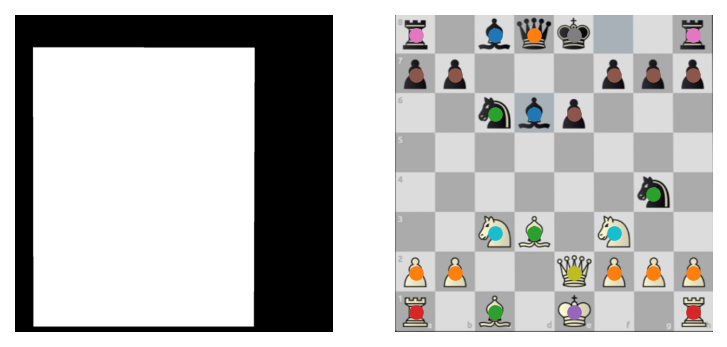

[[ 6  0 10 11  7  0  0  6]
 [ 5  5  0  0  0  5  5  5]
 [ 0  0 12 10  5  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 12  0]
 [ 0  0  9  2  0  9  0  0]
 [ 1  1  0  0  8  1  1  1]
 [ 3  0  2  0  4  0  0  3]]
9.png


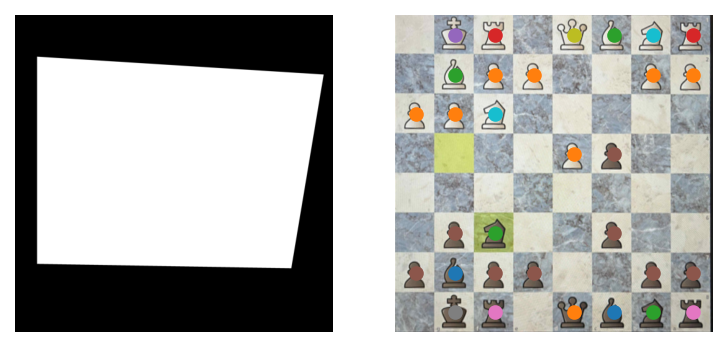

[[ 0  4  3  0  8  2  9  3]
 [ 0  2  1  1  0  0  1  1]
 [ 1  1  9  0  0  0  0  0]
 [ 0  0  0  0  1  5  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  5 12  0  0  5  0  0]
 [ 5 10  5  5  0  0  5  5]
 [ 0  7  6  0 11 10 12  6]]
20.png


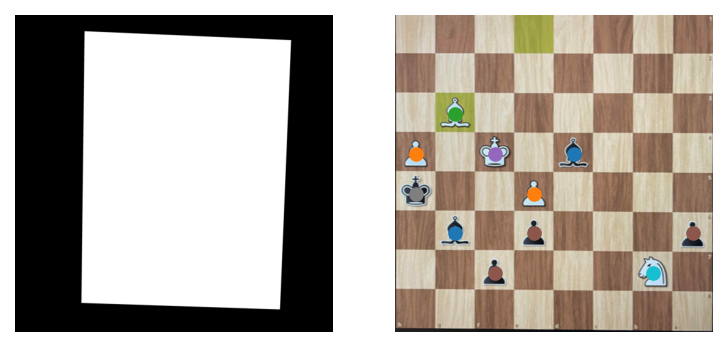

[[ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  2  0  0  0  0  0  0]
 [ 1  0  4  0 10  0  0  0]
 [ 7  0  0  1  0  0  0  0]
 [ 0 10  0  5  0  0  0  5]
 [ 0  0  5  0  0  0  9  0]
 [ 0  0  0  0  0  0  0  0]]
90.png


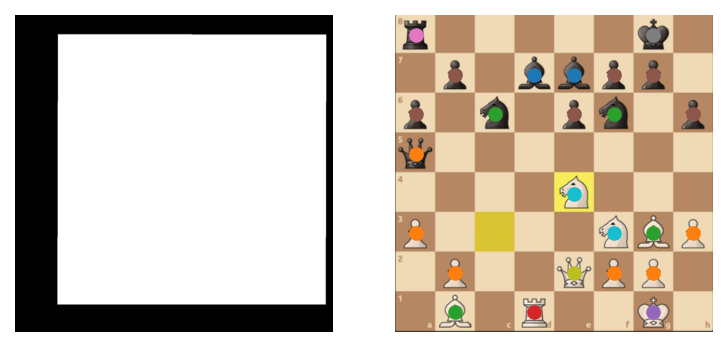

[[ 6  0  0  0  0  0  7  0]
 [ 0  5  0 10 10  5  5  0]
 [ 5  0 12  0  5 12  0  5]
 [11  0  0  0  0  0  0  0]
 [ 0  0  0  0  9  0  0  0]
 [ 1  0  0  0  0  9  2  1]
 [ 0  1  0  0  8  1  1  0]
 [ 0  2  0  3  0  0  4  0]]
31.png


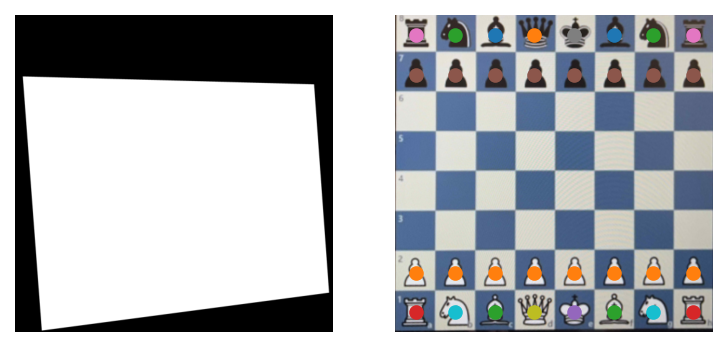

[[ 6 12 10 11  7 10 12  6]
 [ 5  5  5  5  5  5  5  5]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 1  1  1  1  1  1  1  1]
 [ 3  9  2  8  4  2  9  3]]
30.png


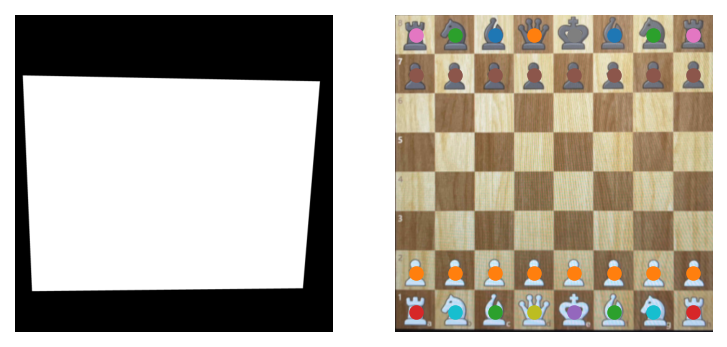

[[ 6 12 10 11  7 10 12  6]
 [ 5  5  5  5  5  5  5  5]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 1  1  1  1  1  1  1  1]
 [ 3  9  2  8  4  2  9  3]]
52.png


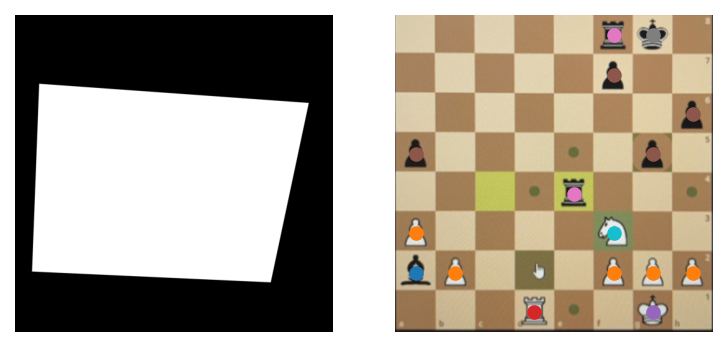

[[ 0  0  0  0  0  6  7  0]
 [ 0  0  0  0  0  5  0  0]
 [ 0  0  0  0  0  0  0  5]
 [ 5  0  0  0  0  0  5  0]
 [ 0  0  0  0  6  0  0  0]
 [ 1  0  0  0  0  9  0  0]
 [10  1  0  0  0  1  1  1]
 [ 0  0  0  3  0  0  4  0]]
41.png


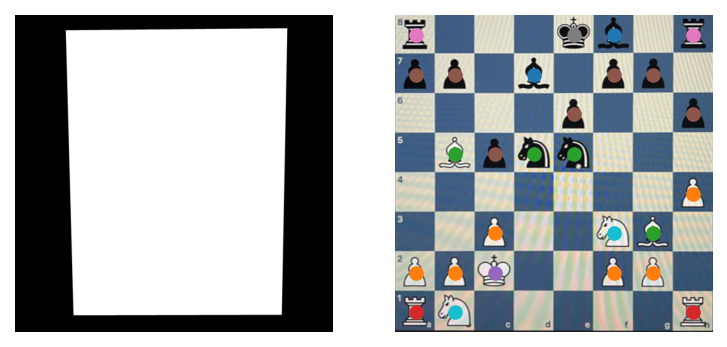

[[ 6  0  0  0  7 10  0  6]
 [ 5  5  0 10  0  5  5  0]
 [ 0  0  0  0  5  0  0  5]
 [ 0  2  5 12 12  0  0  0]
 [ 0  0  0  0  0  0  0  1]
 [ 0  0  1  0  0  9  2  0]
 [ 1  1  4  0  0  1  1  0]
 [ 3  9  0  0  0  0  0  3]]
4.png


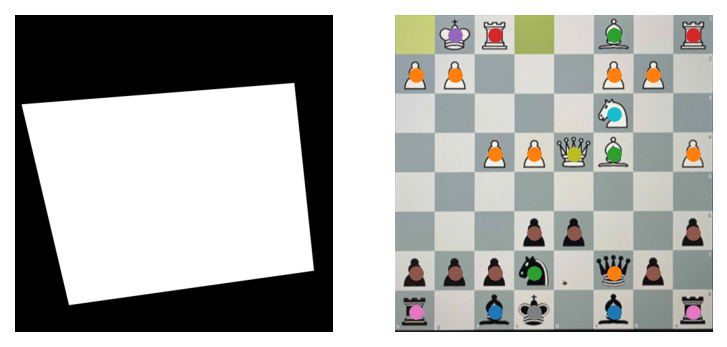

[[ 0  4  3  0  0  2  0  3]
 [ 1  1  0  0  0  1  1  0]
 [ 0  0  0  0  0  9  0  0]
 [ 0  0  1  1  8  2  0  1]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  5  5  0  0  5]
 [ 5  5  5 12  0 11  5  0]
 [ 6  0 10  7  0 10  0  6]]
32.png


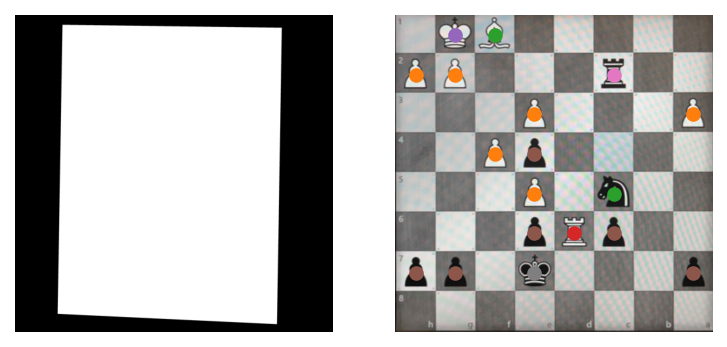

[[ 0  4  2  0  0  0  0  0]
 [ 1  1  0  0  0  6  0  0]
 [ 0  0  0  1  0  0  0  1]
 [ 0  0  1  5  0  0  0  0]
 [ 0  0  0  1  0 12  0  0]
 [ 0  0  0  5  3  5  0  0]
 [ 5  5  0  7  0  0  0  5]
 [ 0  0  0  0  0  0  0  0]]
59.png


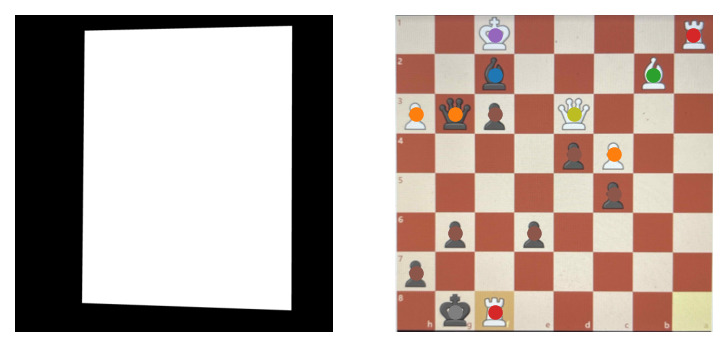

[[ 0  0  4  0  0  0  0  3]
 [ 0  0 10  0  0  0  2  0]
 [ 1 11  5  0  8  0  0  0]
 [ 0  0  0  0  5  1  0  0]
 [ 0  0  0  0  0  5  0  0]
 [ 0  5  0  5  0  0  0  0]
 [ 5  0  0  0  0  0  0  0]
 [ 0  7  3  0  0  0  0  0]]
25.png


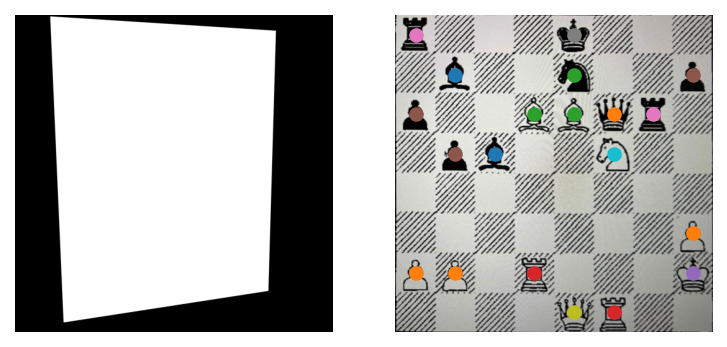

[[ 6  0  0  0  7  0  0  0]
 [ 0 10  0  0 12  0  0  5]
 [ 5  0  0  2  2 11  6  0]
 [ 0  5 10  0  0  9  0  0]
 [ 0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  1]
 [ 1  1  0  3  0  0  0  4]
 [ 0  0  0  0  8  3  0  0]]


In [12]:
class_map = {
    'Empty': 0
}

corrections_and_labels = []

for source, image, label, kp, rot in zip(sources, images, labels, keypoints, rotation):    
    frame_width = image.shape[1]//8
    frame_height = image.shape[0]//8
    
    transform, corrected_image =  correct_perspective(image, label)
    # Use the transform matrix to transform keypoints as well
    label_array = np.zeros((8, 8), np.uint8)
    
    for keypoint in kp:        
        x = keypoint['x']*image.shape[1]
        y = keypoint['y']*image.shape[0]
        
        kp_class = keypoint['type']
        
        if kp_class in ["Square A1", "Square H8"]:
            continue
        
        if rot == 'right':
            x, y = rotate_point(x, y, image.shape[1]/2, image.shape[0]/2, -np.pi/2)
        elif rot == 'left':
            x, y = rotate_point(x, y, image.shape[1]/2, image.shape[0]/2, np.pi/2)
        elif rot == 'upside':
            x, y = rotate_point(x, y, image.shape[1]/2, image.shape[0]/2, -np.pi)
        
        vec = np.array([[[x, y]]])
        out = cv2.perspectiveTransform(vec, transform)
        o_x, o_y = out.squeeze()[0], out.squeeze()[1]
                
        if kp_class not in class_map:
            class_map[kp_class] = len(class_map)
                    
        kp_y = int(o_y)//frame_height
        kp_x = int(o_x)//frame_width
                
        label_array[kp_y, kp_x] = class_map[kp_class]           
        
    print(source)
    plt.subplot(1, 2, 1)
    plt.imshow(label, plt.cm.gray)
    plt.axis("off")
    plt.subplot(1, 2, 2)
    plt.imshow(corrected_image)
    for y in range(8):
        for x in range(8):
            if label_array[y, x] != 0:
                 plt.scatter([x*frame_width+frame_width/2], [y*frame_height+frame_height/2], color=f"C{label_array[y,x]}")
    plt.axis("off")
    plt.gcf().set_dpi(150)
    plt.show()
    print(label_array)
    
    corrections_and_labels.append((corrected_image, label_array))

### Extract patches for training from images

In [47]:
patches = []
labels = []

for img, label_vec in corrections_and_labels:
    frame_width = img.shape[1]//8
    frame_height = img.shape[0]//8
    
    for y in range(8):
        for x in range(8):
            patches.append(
                img[frame_height*y:frame_height*(y+1), frame_width*x:frame_width*(x+1), ...]
            )
            labels.append(label_vec[y, x])

In [48]:
unique_labels, counts = np.unique(labels, return_counts=True)

Class representation

In [49]:
reverse_class_map = {v: k for k,v in class_map.items()}

for label, count in sorted(zip(unique_labels, counts), key=lambda x: x[1], reverse=True):
    print(reverse_class_map[label], f": {count} entries")

Empty : 3934 entries
Black pawn : 531 entries
White pawn : 510 entries
White rook : 152 entries
Black rook : 147 entries
White bishop : 118 entries
Black bishop : 112 entries
White knight : 97 entries
White king : 94 entries
Black king : 94 entries
Black knight : 92 entries
Black queen : 69 entries
White queen : 66 entries


In [50]:
classification_dataset_dir = os.path.join('..', 'classification_data')

import shutil

try:
    shutil.rmtree(classification_dataset_dir)
except: pass

try:
    os.makedirs(classification_dataset_dir)
except: pass

In [51]:
with open(os.path.join(classification_dataset_dir, "class_map.json"), 'w') as cmap:
    json.dump(reverse_class_map, cmap)

In [52]:
for idx, (patch, label) in enumerate(zip(patches, labels)):
    fname = f"{idx}_class_{label}.png"
    
    output_path = os.path.join(classification_dataset_dir, fname)
    out = Image.fromarray((patch*255).astype(np.uint8))
    out.save(output_path)